In [1]:
import pandas as pd
import scanpy as sc 
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import rcParams
import os,re


In [2]:
os.chdir("/home/maolp/data5/Gaofeng_All_matrix/Allcount")

In [3]:
%load_ext rpy2.ipython

In [4]:
%%R
source("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_script_in_save/HFB_Figure1_Umap.R")

R[write to console]: 
载入程辑包：‘dplyr’


R[write to console]: The following objects are masked from ‘package:stats’:

    filter, lag


R[write to console]: The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [5]:
%%R -w 3000 -h 1200 -r 180
library(ggsci)
cols01 <- c("#f49128", "#194a55", "#187c65", "#f26115", "#c29f62", "#83ba9e")
cols02 <- c("#c62d17", "#023f75", "#ea894e", "#266b69", "#eb4601", "#f6c619")
cols03 <- c("#fa6e01", "#2f2f2f", "#972b1d", "#e6a84b", "#4c211b", "#ff717f")
cols04 <- c("#223e9c", "#b12b23", "#aebea6", "#edae11", "#0f6657", "#c74732")
cols05 <- c("#6a73cf", "#edd064", "#0eb0c8", "#f2ccac", "#a1d5b9", "#e1abbc")

all_colors <- c(cols01, cols02, cols03, cols04, cols05)
all_colors
colorname2=c(pal_futurama()(12),"#46A040","#00AF99" ,"#98D9E9" ,"#F6313E", "#FFA300","#2f2f2f",  "#FFC179", 
"#FF5A00", "#663366","#FF6666","#8F1336", "#0081C9", "#001588", "#CC0033",
"#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#0eb0c8","#993333","#333366",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#B5AD64",
"#9DA8E2","#91C392", "#194a55", "#187c65", "#c29f62","#f49128","#c62d17", "#333329",
"#023f75", "#ea894e", "#266b69",  "#e1abbc","#f6c619","#fa6e01", "#972b1d", "#e6a84b", "#4c211b", "#ff717f","#223e9c", 
"#aebea6", "#edae11", "#c74732", "#6a73cf", "#edd064" , 
"#0eb0c8", "#f2ccac" ,"#868686","#339966", "#83ba9e", "#b12b23", "#0f6657","#f26115","#eb4601")
colorname3=colorname2
length(colorname3)

[1] 76


In [6]:
%%R
library(ggsci)
pal_futurama()(12)

 [1] "#FF6F00FF" "#C71000FF" "#008EA0FF" "#8A4198FF" "#5A9599FF" "#FF6348FF"
 [7] "#84D7E1FF" "#FF95A8FF" "#3D3B25FF" "#ADE2D0FF" "#1A5354FF" "#3F4041FF"


In [7]:
mkdir -p /home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1

In [8]:
# adata1=sc.read_h5ad('/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad')

In [9]:
ls All_scanpyData/

Bcell/                                      milodata/
BCRFigure/                                  Milo_Data/
BCR_Figure/                                 Milo_TFpycienic/
BCRTCR/                                     Monolike/
BCRTCRchain/                                RNAseq/
Bdata/                                      SingleCell_PBMCexpdata_logtpm.csv
Cellchat/                                   Smallpercentage/
ColorDict/                                  SubAdata/
Count/                                      TCRchain/
Countplot/                                  TCRFigure/
D2_scanpy_merge_rmdoubulet_log1p_PCA.h5ad*  Time/
D2_scanpy_merge_rmdoubulet_UMAP2.h5ad*      Time2/
Data/                                       Time3/
Figure_V2/                                  Time4/
Last_Hotspot/                               Time5/
MetaData/                                   UmapData/


In [10]:
%%R -w 1800 -h 1600 -r 180

library(ggplot2)
library(ggrepel)
library(scRNAtoolVis)
library(Seurat)
library(jjPlot)



umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
head(umap_data)
umap_data_center <- umap_data %>%
  group_by(Cell_Type_Code) %>%
  summarise(x_m = median(UMAP1), y_m = median(UMAP2))%>%mutate(Cell_Type_Code=factor(Cell_Type_Code))
head(umap_data_center)

R[write to console]: 载入需要的程辑包：tidyverse



── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ forcats   1.0.0     ✔ readr     2.1.4
✔ lubridate 1.9.2     ✔ tibble    3.2.1
✔ purrr     1.0.1     ✔ tidyr     1.3.0
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

R[write to console]: Attaching SeuratObject



# A tibble: 6 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 1              0.172 14.0 
2 2              4.35  13.7 
3 3              3.00  15.7 
4 4              0.578  8.50
5 5              0.504  6.01
6 6              1.20   6.34


In [11]:
%%R -w 1800 -h 2600 -r 180


# 加载必要的R包
library(ggplot2)
library(ggrepel)
library(dplyr)
library(scRNAtoolVis)
# library(Seurat)
library(jjPlot)
# 从CSV文件中读取数据
umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
umap_data$Cell_Type_Code<-factor(umap_data$Cell_Type_Code)
umap_data$Cell_Type2<-paste0(umap_data$Cell_Type_Code,"_",umap_data$Cell_Type)
umap_data$Cell_Type2<-factor(umap_data$Cell_Type2)
head(umap_data)
levels(umap_data$Cell_Type2)
# 加载所需的库
library(dplyr)
library(stringr)


sorted_levels <- umap_data$Cell_Type2 %>% 
  levels() %>% 
  data.frame(Cell_Type2 = .) %>% 
  mutate(Num = as.numeric(str_extract(Cell_Type2, "\\d+"))) %>% 
  arrange(Num) %>% 
  pull(Cell_Type2)


umap_data$Cell_Type2 <- factor(umap_data$Cell_Type2, levels = sorted_levels)


levels(umap_data$Cell_Type2)


 [1] "1_HSC_MPP"               "2_MEP"                  
 [3] "3_MEMP"                  "4_Pro-B"                
 [5] "5_Large pre-B"           "6_Small pre-B"          
 [7] "7_CXCR5- Naïve B"        "8_CXCR5+ Naïve B"       
 [9] "9_DN(Q) T"               "10_DP(P) T"             
[11] "11_DP(Q) T"              "12_Treg"                
[13] "13_Cycling Treg"         "14_Naïve CD4 T"         
[15] "15_Naïve CD8 T"          "16_abT(entry)"          
[17] "17_Tem"                  "18_Th17like_INNATE_T"   
[19] "19_NK T"                 "20_Gamma Delta V1 T"    
[21] "21_Gamma Delta V2 T"     "22_GNG4 +CD8aa+T"       
[23] "23_ILC2/3"               "24_CX3CR1+ NK"          
[25] "25_CXCR6+ NK"            "26_CD56highCD16low NK"  
[27] "27_Myeloid-CD177"        "28_Classical Monocytes" 
[29] "29_CD14+PPBP+ Monocytes" "30_Macrophages"         
[31] "31_DC1"                  "32_DC2"                 
[33] "33_pDC"                  "34_Megakaryocytes"      
[35] "35_Early_ERY"            

In [12]:
%%R
table(umap_data$Cell_Type2)


              1_HSC_MPP                   2_MEP                  3_MEMP 
                   3248                    1134                    2527 
                4_Pro-B           5_Large pre-B           6_Small pre-B 
                    850                    1099                     160 
       7_CXCR5- Naïve B        8_CXCR5+ Naïve B               9_DN(Q) T 
                   8381                   26800                    5410 
             10_DP(P) T              11_DP(Q) T                 12_Treg 
                   8119                    4025                    4546 
        13_Cycling Treg          14_Naïve CD4 T          15_Naïve CD8 T 
                     62                   38253                   14659 
          16_abT(entry)                  17_Tem    18_Th17like_INNATE_T 
                   8456                     448                    2074 
                19_NK T     20_Gamma Delta V1 T     21_Gamma Delta V2 T 
                   1649                     328   

In [13]:
cols01 = ["#f49128", "#194a55", "#187c65", "#f26115", "#c29f62", "#83ba9e"]
cols02 = ["#c62d17", "#023f75", "#ea894e", "#266b69", "#eb4601", "#f6c619"]
cols03 = ["#fa6e01", "#2f2f2f", "#972b1d", "#e6a84b", "#4c211b", "#ff717f"]
cols04 = ["#223e9c", "#b12b23", "#aebea6", "#edae11", "#0f6657", "#c74732"]
cols05 = ["#6a73cf", "#edd064", "#0eb0c8", "#f2ccac", "#a1d5b9", "#e1abbc"]

all_colors = cols01 + cols02 + cols03 + cols04 + cols05

colorname2 = [
    "#46A040", "#00AF99", "#FFC179", "#98D9E9", "#F6313E", "#FFA300", "#333366",
    "#FF5A00", "#663366", "#FF6666", "#8F1336", "#0081C9", "#001588", "#CC0033",
    "#CC9966", "#CC0033", "#999933", "#009966", "#CCCC33", "#CCFF99", "#333399",
    "#993333", "#490C65", "#BA7FD0", "#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A",
    "#006D2C", "#868686", "#B5AD64", "#9DA8E2", "#91C392", "#FF9900", "#339966"
] + all_colors

colorname3 = colorname2[:]

print(colorname3)
print(len(colorname3))


['#46A040', '#00AF99', '#FFC179', '#98D9E9', '#F6313E', '#FFA300', '#333366', '#FF5A00', '#663366', '#FF6666', '#8F1336', '#0081C9', '#001588', '#CC0033', '#CC9966', '#CC0033', '#999933', '#009966', '#CCCC33', '#CCFF99', '#333399', '#993333', '#490C65', '#BA7FD0', '#A6CEE3', '#1F78B4', '#DE77AE', '#B2DF8A', '#006D2C', '#868686', '#B5AD64', '#9DA8E2', '#91C392', '#FF9900', '#339966', '#f49128', '#194a55', '#187c65', '#f26115', '#c29f62', '#83ba9e', '#c62d17', '#023f75', '#ea894e', '#266b69', '#eb4601', '#f6c619', '#fa6e01', '#2f2f2f', '#972b1d', '#e6a84b', '#4c211b', '#ff717f', '#223e9c', '#b12b23', '#aebea6', '#edae11', '#0f6657', '#c74732', '#6a73cf', '#edd064', '#0eb0c8', '#f2ccac', '#a1d5b9', '#e1abbc']
65


In [14]:
colname4=[ "#C71000FF", "#008EA0FF", "#8A4198FF", "#5A9599FF", 
"#FF6348FF", "#84D7E1FF", "#FF95A8FF", "#3D3B25FF", "#ADE2D0FF",
"#1A5354FF", "#3F4041FF","#fa6e01","#972b1d", "#e6a84b", "#4c211b", "#ff717f", "#009966",
"#c62d17", "#023f75", "#ea894e", "#266b69", "#eb4601", "#f6c619",
"#f49128", "#194a55", "#c29f62", "#83ba9e","#187c65", "#A6CEE3",
"#223e9c", "#aebea6", "#edae11", "#c74732",
"#6a73cf", "#edd064", "#0eb0c8", "#f2ccac", "#a1d5b9", "#e1abbc",
"#46A040", "#00AF99", "#FFC179", "#98D9E9", "#F6313E", "#FFA300", 
"#333366", "#663366", "#FF6666", "#8F1336", "#0081C9",  "#CC0033",
"#CC9966", "#CC0033", "#999933", "#CCCC33", "#CCFF99", "#333399","#001588",
 "#490C65", "#BA7FD0", "#1F78B4", "#DE77AE" , "#2f2f2f",
"#006D2C", "#868686", "#9DA8E2", "#91C392", "#FF9900", "#339966","#993333"]

In [15]:
umap_data = pd.read_csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv",index_col=0)

In [16]:
umap_data 

,UMAP1,UMAP2,cluster,Cell_Type,Cell_lineage,organ,new_Body,TCRBCR,Cell_Type_Code,Name,...,total_counts,total_counts_mt,pct_counts_mt,leiden,Last_cell_type,Cell_lineage.1,Last_cell_type2,Last_cell_type_num,Last_cell_type_num2,Last_cellm
Cellname,,,,,,,,,,,,,,,,,,,,,
Z48_AAACCTGAGATAGGAG-1,-4.503597,8.346928,12,CXCR5- Naïve B,B_CELL,PBMC,PBMC,BCR,7,Z48,...,3199.97220,31.894009,0.996696,12,CXCR5- Naïve B,B_CELL,CXCR5- Naïve B,7_CXCR5- Naïve B,7,CXCR5- Naïve B
Z48_AAACCTGAGGCACATG-1,15.739136,13.012819,7,Late_ERY,MK/ERY,PBMC,PBMC,None,37,Z48,...,604.97570,22.320606,3.689504,7,Late_ERY,MK/ERY,Late_ERY,37_Late_ERY,37,Late_ERY
Z48_AAACCTGAGGTGCAAC-1,9.844523,11.883123,10,Mid_ERY,MK/ERY,PBMC,PBMC,None,36,Z48,...,1092.28740,4.007014,0.366846,10,Mid_ERY,MK/ERY,Mid_ERY,36_Mid_ERY,36,Mid_ERY
Z48_AAACCTGCAAGAGTCG-1,11.173142,16.108230,1,Late_ERY,MK/ERY,PBMC,PBMC,None,37,Z48,...,798.59540,15.195499,1.902778,1,Late_ERY,MK/ERY,Late_ERY,37_Late_ERY,37,Late_ERY
Z48_AAACCTGCACACCGAC-1,15.820956,16.131008,7,Late_ERY,MK/ERY,PBMC,PBMC,None,37,Z48,...,538.93823,9.768126,1.812476,7,Late_ERY,MK/ERY,Late_ERY,37_Late_ERY,37,Late_ERY
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Z123_TTTGTCATCGCAAGCC-1,15.983308,12.723680,7,Late_ERY,MK/ERY,PBMC,PBMC,None,37,Z123,...,471.29718,16.462643,3.493049,7,Late_ERY,MK/ERY,Late_ERY,37_Late_ERY,37,Late_ERY
Z123_TTTGTCATCTAACTCT-1,13.517138,14.161664,1,Late_ERY,MK/ERY,PBMC,PBMC,None,37,Z123,...,660.46344,20.279440,3.070486,1,Late_ERY,MK/ERY,Late_ERY,37_Late_ERY,37,Late_ERY
Z123_TTTGTCATCTACTTAC-1,12.454864,1.801341,13,Th17like_INNATE_T,T/ILC,PBMC,PBMC,TCR,18,Z123,...,2438.59350,33.604065,1.378010,13,Th17like_INNATE_T,T/ILC,Th17like_INNATE_T,18_Th17like_INNATE_T,18,Th17like_INNATE_T


In [17]:
umap_data['Last_cell_type_num'].unique()

array(['7_CXCR5- Naïve B', '37_Late_ERY', '36_Mid_ERY', '12_Treg',
       '8_CXCR5+ Naïve B', '18_Th17like_INNATE_T', '14_Naïve CD4 T',
       '2_MEP', '34_Megakaryocytes', '15_Naïve CD8 T',
       '21_Gamma Delta V2 T', '35_Early_ERY', '26_CD56highCD16low NK',
       '24_CX3CR1+ NK', '19_NK T', '23_ILC2/3', '32_DC2',
       '28_Classical Monocytes', '3_MEMP', '1_HSC_MPP', '33_pDC',
       '27_Myeloid-CD177', '17_Tem', '4_Pro-B', '16_abT(entry)',
       '39_Others', '25_CXCR6+ NK', '29_CD14+PPBP+ Monocytes',
       '22_GNG4 +CD8aa+T', '5_Large pre-B', '20_Gamma Delta V1 T',
       '38_Endothelial cells', '31_DC1', '9_DN(Q) T', '11_DP(Q) T',
       '13_Cycling Treg', '10_DP(P) T', '30_Macrophages', '6_Small pre-B'],
      dtype=object)

In [18]:
cell_color_dict = {}

for cell_type, color in zip(umap_data['Last_cell_type_num'].unique(), colname4):
    cell_color_dict[cell_type] = color


In [19]:
cell_color_dict

{'7_CXCR5- Naïve B': '#C71000FF',
 '37_Late_ERY': '#008EA0FF',
 '36_Mid_ERY': '#8A4198FF',
 '12_Treg': '#5A9599FF',
 '8_CXCR5+ Naïve B': '#FF6348FF',
 '18_Th17like_INNATE_T': '#84D7E1FF',
 '14_Naïve CD4 T': '#FF95A8FF',
 '2_MEP': '#3D3B25FF',
 '34_Megakaryocytes': '#ADE2D0FF',
 '15_Naïve CD8 T': '#1A5354FF',
 '21_Gamma Delta V2 T': '#3F4041FF',
 '35_Early_ERY': '#fa6e01',
 '26_CD56highCD16low NK': '#972b1d',
 '24_CX3CR1+ NK': '#e6a84b',
 '19_NK T': '#4c211b',
 '23_ILC2/3': '#ff717f',
 '32_DC2': '#009966',
 '28_Classical Monocytes': '#c62d17',
 '3_MEMP': '#023f75',
 '1_HSC_MPP': '#ea894e',
 '33_pDC': '#266b69',
 '27_Myeloid-CD177': '#eb4601',
 '17_Tem': '#f6c619',
 '4_Pro-B': '#f49128',
 '16_abT(entry)': '#194a55',
 '39_Others': '#c29f62',
 '25_CXCR6+ NK': '#83ba9e',
 '29_CD14+PPBP+ Monocytes': '#187c65',
 '22_GNG4 +CD8aa+T': '#A6CEE3',
 '5_Large pre-B': '#223e9c',
 '20_Gamma Delta V1 T': '#aebea6',
 '38_Endothelial cells': '#edae11',
 '31_DC1': '#c74732',
 '9_DN(Q) T': '#6a73cf',
 '11_

In [20]:
mkdir -p All_scanpyData/ColorDict

In [21]:
import json

with open("./All_scanpyData/ColorDict/Celltype_colors_dict.json", "w") as outfile:
    json.dump(cell_color_dict, outfile)

In [22]:
Cellcolors = list(cell_color_dict.values())


In [23]:
with open("./All_scanpyData/ColorDict/Celltype_colors_dict.json", "r") as infile:
    loaded_colors_dict = json.load(infile)

print(loaded_colors_dict)

{'7_CXCR5- Naïve B': '#C71000FF', '37_Late_ERY': '#008EA0FF', '36_Mid_ERY': '#8A4198FF', '12_Treg': '#5A9599FF', '8_CXCR5+ Naïve B': '#FF6348FF', '18_Th17like_INNATE_T': '#84D7E1FF', '14_Naïve CD4 T': '#FF95A8FF', '2_MEP': '#3D3B25FF', '34_Megakaryocytes': '#ADE2D0FF', '15_Naïve CD8 T': '#1A5354FF', '21_Gamma Delta V2 T': '#3F4041FF', '35_Early_ERY': '#fa6e01', '26_CD56highCD16low NK': '#972b1d', '24_CX3CR1+ NK': '#e6a84b', '19_NK T': '#4c211b', '23_ILC2/3': '#ff717f', '32_DC2': '#009966', '28_Classical Monocytes': '#c62d17', '3_MEMP': '#023f75', '1_HSC_MPP': '#ea894e', '33_pDC': '#266b69', '27_Myeloid-CD177': '#eb4601', '17_Tem': '#f6c619', '4_Pro-B': '#f49128', '16_abT(entry)': '#194a55', '39_Others': '#c29f62', '25_CXCR6+ NK': '#83ba9e', '29_CD14+PPBP+ Monocytes': '#187c65', '22_GNG4 +CD8aa+T': '#A6CEE3', '5_Large pre-B': '#223e9c', '20_Gamma Delta V1 T': '#aebea6', '38_Endothelial cells': '#edae11', '31_DC1': '#c74732', '9_DN(Q) T': '#6a73cf', '11_DP(Q) T': '#edd064', '13_Cycling T

In [24]:
with open("./All_scanpyData/ColorDict/Celltype_colors_dict.json", "r") as infile:
    loaded_colors_dict = json.load(infile)

print(loaded_colors_dict)


{'7_CXCR5- Naïve B': '#C71000FF', '37_Late_ERY': '#008EA0FF', '36_Mid_ERY': '#8A4198FF', '12_Treg': '#5A9599FF', '8_CXCR5+ Naïve B': '#FF6348FF', '18_Th17like_INNATE_T': '#84D7E1FF', '14_Naïve CD4 T': '#FF95A8FF', '2_MEP': '#3D3B25FF', '34_Megakaryocytes': '#ADE2D0FF', '15_Naïve CD8 T': '#1A5354FF', '21_Gamma Delta V2 T': '#3F4041FF', '35_Early_ERY': '#fa6e01', '26_CD56highCD16low NK': '#972b1d', '24_CX3CR1+ NK': '#e6a84b', '19_NK T': '#4c211b', '23_ILC2/3': '#ff717f', '32_DC2': '#009966', '28_Classical Monocytes': '#c62d17', '3_MEMP': '#023f75', '1_HSC_MPP': '#ea894e', '33_pDC': '#266b69', '27_Myeloid-CD177': '#eb4601', '17_Tem': '#f6c619', '4_Pro-B': '#f49128', '16_abT(entry)': '#194a55', '39_Others': '#c29f62', '25_CXCR6+ NK': '#83ba9e', '29_CD14+PPBP+ Monocytes': '#187c65', '22_GNG4 +CD8aa+T': '#A6CEE3', '5_Large pre-B': '#223e9c', '20_Gamma Delta V1 T': '#aebea6', '38_Endothelial cells': '#edae11', '31_DC1': '#c74732', '9_DN(Q) T': '#6a73cf', '11_DP(Q) T': '#edd064', '13_Cycling T

In [25]:
%%R -w 1800 -h 2600 -r 180

library(jsonlite)
file_path <- "./All_scanpyData/ColorDict/Celltype_colors_dict.json"
colors_dict <- fromJSON(file_path)
# colors_dict

R[write to console]: 
载入程辑包：‘jsonlite’


R[write to console]: The following object is masked from ‘package:purrr’:

    flatten




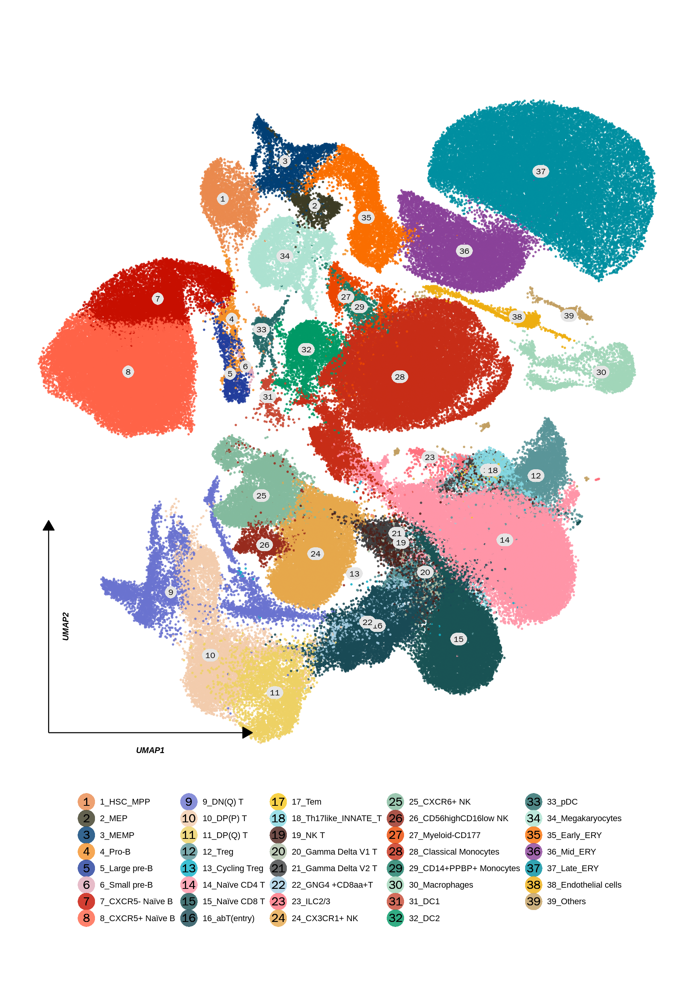

In [26]:
%%R -w 1800 -h 2600 -r 180


library(ggplot2)
library(ggrepel)
library(dplyr)
library(scRNAtoolVis)
# library(Seurat)
library(jjPlot)

# umap_data <- read.csv("../All_scanpydata/Scanpy_Subdata/adata1_umap_data.csv", row.names = 1)
umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
umap_data$Cell_Type_Code<-factor(umap_data$Cell_Type_Code)
umap_data$Cell_Type2<-paste0(umap_data$Cell_Type_Code,"_",umap_data$Cell_Type)
umap_data$Cell_Type2<-factor(umap_data$Cell_Type2)
head(umap_data)
levels(umap_data$Cell_Type2)

library(dplyr)
library(stringr)
library(grid)
draw_number_circle <- function(data,params,size){
  grid::grobTree(pointsGrob(x = 0.5,y = 0.5,
                      size = unit(2,"char"),
                      pch = 16,
                      gp = gpar(
                        col = alpha(data$colour %||% "grey50",data$alpha),
                        fill = alpha(data$fill %||% "grey50",data$alpha),
                        lwd = (data$linewidth %||% 0.5)* .pt,
                        lty = data$linetype %||% 1)),
  textGrob(label = data$label,
           x = rep(0.5,3),y = rep(0.5,3),
           gp = gpar(col = "black"))
  )

}


sorted_levels <- umap_data$Cell_Type2 %>% 
  levels() %>% 
  data.frame(Cell_Type2 = .) %>% 
  mutate(Num = as.numeric(str_extract(Cell_Type2, "\\d+"))) %>% 
  arrange(Num) %>% 
  pull(Cell_Type2)


umap_data$Cell_Type2 <- factor(umap_data$Cell_Type2, levels = sorted_levels)

levels(umap_data$Cell_Type2)

umap_data_center <- umap_data %>%
  group_by(Cell_Type_Code) %>%
  summarise(x_m = median(UMAP1), y_m = median(UMAP2))%>%mutate(Cell_Type_Code=factor(Cell_Type_Code))
head(umap_data_center)
umap_data$facet <- "umap"
umap_plot <- ggplot() +
  geom_point(data=umap_data, aes(x = UMAP1, y = UMAP2, color = Cell_Type2),size = 0.5, alpha = 0.8,key_glyph = draw_number_circle) +
  geom_label(
    data = umap_data_center,
    aes(x = x_m, y = y_m, label = Cell_Type_Code),
    size = 3,
    fill = "grey90",
    label.size = NA, label.r = unit(0.25, "cm")
  ) +
  scale_color_manual(values = colors_dict) + 
  xlab("UMAP1") +
  ylab("UMAP2") +
  coord_fixed()+
guides(color = guide_legend(override.aes = list(label = levels(factor(umap_data$Cell_Type_Code)),size = 6)))+
geom_markArrow(data = umap_data,rel.pos = 0.06,label.shift = c(0.025,-0.025))+
  theme_minimal() +
  theme(panel.spacing.y = unit(0,"mm"),
        axis.text = element_text(color = "black"),
        axis.text.y = element_blank(),
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        axis.title = element_blank(),axis.line = element_blank(), 
        strip.text = element_text(face = "bold"),legend.position = "bottom") +labs(color="")


print(umap_plot)
# ggsave(plot=umap_plot,width=12,height=16,"../All_scanpydata/Scanpy_Subdata/Figure_V1//umap_plot.pdf")

In [27]:
# !mkdir -p ./All_scanpyData/Figure_V2

In [28]:
%%R -w 1800 -h 2600 -r 180
ggsave(plot=umap_plot,width=12,height=12,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure1/Figure1C_umap_plot.pdf")

In [29]:
%%R -w 1800 -h 2600 -r 180
umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
head(umap_data)

                           UMAP1     UMAP2 cluster      Cell_Type Cell_lineage
Z48_AAACCTGAGATAGGAG-1 -4.503597  8.346928      12 CXCR5- Naïve B       B_CELL
Z48_AAACCTGAGGCACATG-1 15.739136 13.012819       7       Late_ERY       MK/ERY
Z48_AAACCTGAGGTGCAAC-1  9.844523 11.883123      10        Mid_ERY       MK/ERY
Z48_AAACCTGCAAGAGTCG-1 11.173142 16.108230       1       Late_ERY       MK/ERY
Z48_AAACCTGCACACCGAC-1 15.820956 16.131008       7       Late_ERY       MK/ERY
Z48_AAACCTGCACTGTCGG-1 12.052043 16.930082       1       Late_ERY       MK/ERY
                       organ new_Body TCRBCR Cell_Type_Code Name doublet_scores
Z48_AAACCTGAGATAGGAG-1  PBMC     PBMC    BCR              7  Z48     0.06542056
Z48_AAACCTGAGGCACATG-1  PBMC     PBMC   None             37  Z48     0.15034965
Z48_AAACCTGAGGTGCAAC-1  PBMC     PBMC   None             36  Z48     0.03421462
Z48_AAACCTGCAAGAGTCG-1  PBMC     PBMC   None             37  Z48     0.07486034
Z48_AAACCTGCACACCGAC-1  PBMC     PBMC   None   

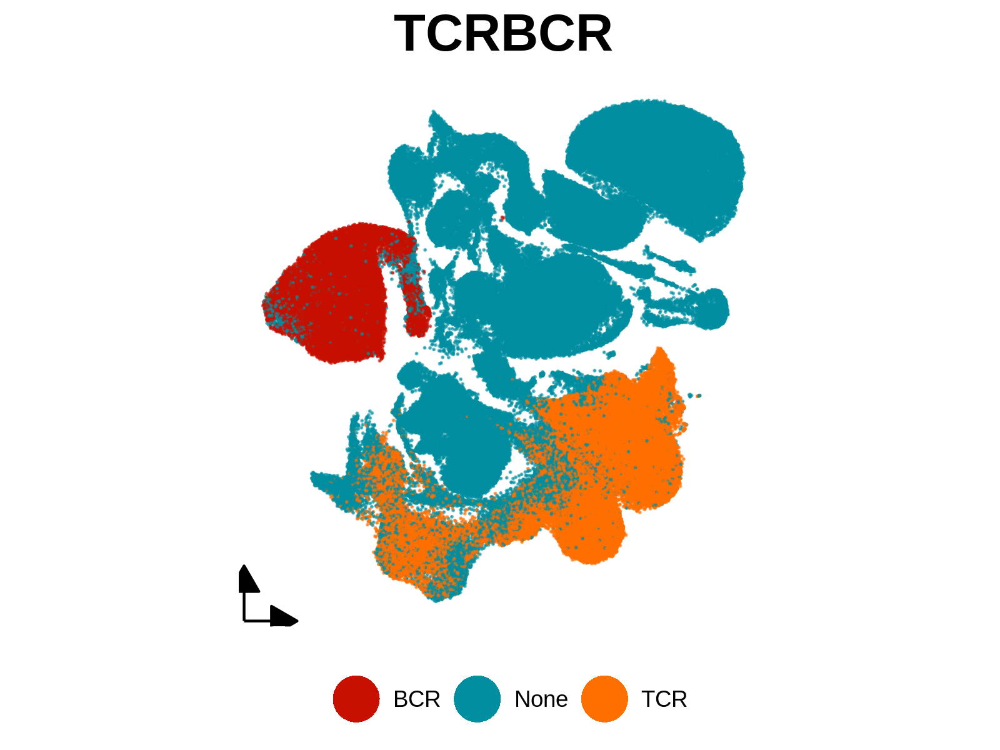

In [30]:
%%R -w 1600 -h 1200 -r 300

umap_TCRBCR <- ggplot() +
  geom_point(data=umap_data, aes(x = UMAP1, y = UMAP2, color =TCRBCR),size = 0.01, alpha = 0.6,key_glyph = draw_number_circle) +
  scale_color_manual(values = c("#C71000FF" ,"#008EA0FF","#FF6F00FF" )) + 
  xlab("UMAP1") +
  ylab("UMAP2") +
  coord_fixed()+
# guides(color = guide_legend(override.aes = list(size = 4),ncol =1))+
geom_markArrow(data = umap_data,rel.pos = 0.01,rel.len = 0.1)+
  theme_minimal() +
  theme(panel.spacing.y = unit(0,"mm"),
        axis.text = element_text(color = "black"),
        axis.text.y = element_blank(),
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        axis.title = element_blank(),axis.line = element_blank(), 
        strip.text = element_text(face = "bold"),legend.position = "bottom") +labs(color="")+ggtitle("TCRBCR")+ 
theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))+guides(color = guide_legend(override.aes = list(size = 5, alpha = 1)))


print(umap_TCRBCR)
ggsave(plot=umap_TCRBCR,width=8,height=8,"./All_scanpyData/Figure_V2/umap_TCRBCR2.pdf")

In [31]:
mkdir -p /home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2

In [32]:
%%R
ggsave(plot=umap_TCRBCR,width=12,height=16,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_TCRBCR.pdf")

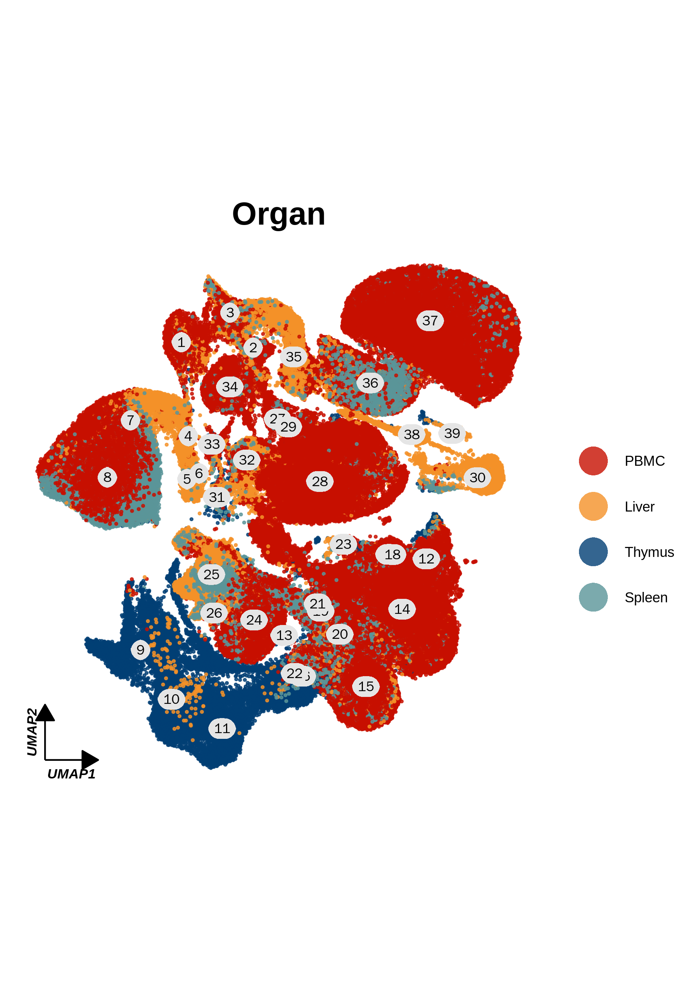

In [33]:
%%R -w 1800 -h 2600 -r 300

umap_data$organ<-factor(umap_data$organ,level=c('PBMC','Liver','Thymus','Spleen'))
umap_organ <- ggplot() +
  geom_point(data=umap_data, aes(x = UMAP1, y = UMAP2, color =organ),size = 0.5, alpha = 0.8,key_glyph = draw_number_circle) +
  geom_label(
    data = umap_data_center,
    aes(x = x_m, y = y_m, label = Cell_Type_Code),
    size = 3,
    fill = "grey90",
    label.size = NA, label.r = unit(0.25, "cm")
  ) +
  scale_color_manual(values = c('#C71000FF',"#f49128","#023f75","#5A9599FF") ) + 
  xlab("UMAP1") +
  ylab("UMAP2") +
  coord_fixed()+
guides(color = guide_legend(override.aes = list(size = 10),ncol =1))+
geom_markArrow(data = umap_data,rel.pos = 0.06,rel.len = 0.1)+
  theme_minimal() +
  theme(panel.spacing.y = unit(0,"mm"),
        axis.text = element_text(color = "black"),
        axis.text.y = element_blank(),
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        axis.title = element_blank(),axis.line = element_blank(), 
        strip.text = element_text(face = "bold"),legend.position = "right") +labs(color="")+ggtitle("Organ")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))


print(umap_organ)
ggsave(plot=umap_organ,width=10,height=10,"./All_scanpyData/Figure_V2//umap_Organ.pdf")

In [34]:
%%R -w 1800 -h 2600 -r 180
ggsave(plot=umap_organ,width=9,height=9,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure1/Figure1D_umap_Organ.pdf")
# ggsave(plot=umap_plot,width=12,height=16,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_TCRBCR.pdf")

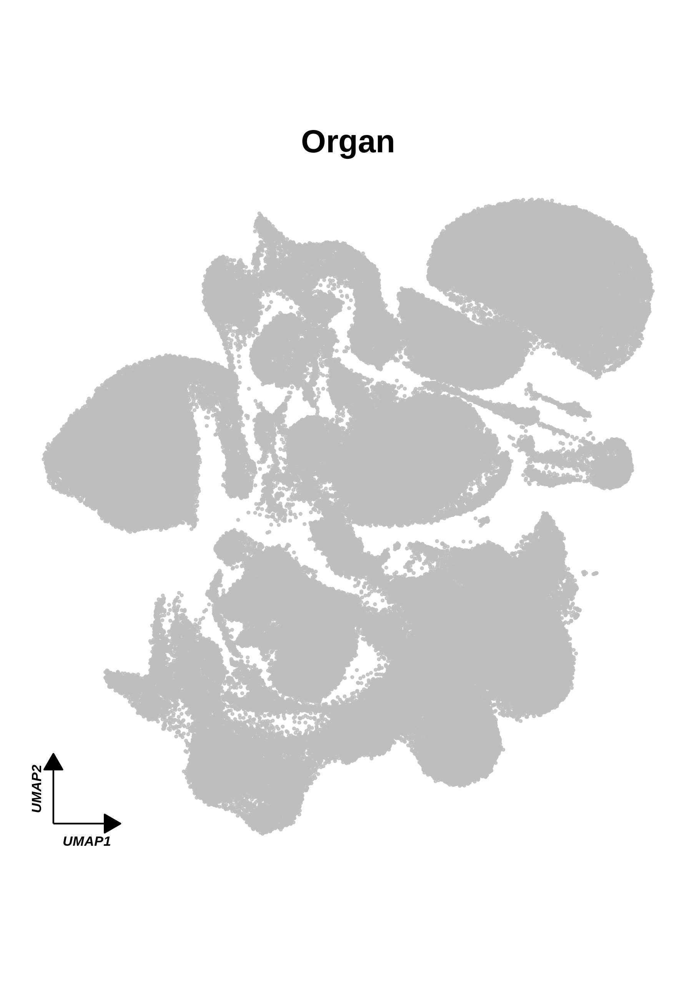

In [35]:
%%R -w 1800 -h 2600 -r 300


umap_grey <- ggplot() +
  geom_point(data=umap_data, aes(x = UMAP1, y = UMAP2),color ="grey",size = 0.5, alpha = 0.8) +
  scale_color_manual(values = c("#F6313E","#fb862b","#0eb0c8","#6a73cf") ) + 
  xlab("UMAP1") +
  ylab("UMAP2") +
  coord_fixed()+
guides(color = guide_legend(override.aes = list(size = 10),ncol =1))+
geom_markArrow(data = umap_data,rel.pos = 0.06,rel.len = 0.1)+
  theme_minimal() +
  theme(panel.spacing.y = unit(0,"mm"),
        axis.text = element_text(color = "black"),
        axis.text.y = element_blank(),
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        axis.title = element_blank(),axis.line = element_blank(), 
        strip.text = element_text(face = "bold"),legend.position = "right") +labs(color="")+ggtitle("Organ")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))


print(umap_grey)

# ggsave(plot=umap_organ,width=12,height=12,"./All_scanpyData/Figure_V2//umap_Organ.pdf")

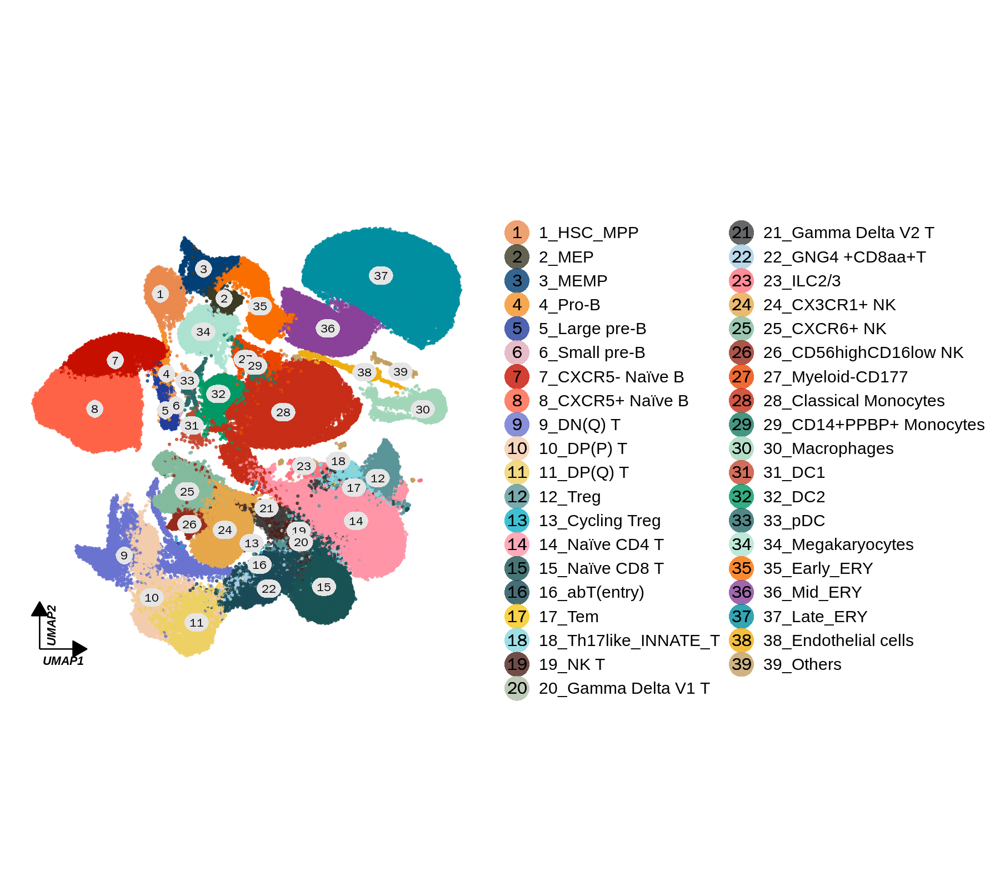

In [36]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
umap_plot <- create_umap_plot(umap_data=umap_data, colors_dict=colors_dict) + 
geom_markArrow(data = umap_data,rel.pos = 0.06,rel.len=0.1, label.shift = c(0.025, -0.025))


print(umap_plot)

ggsave(plot = umap_plot, width = 22, height = 12, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure1/Figure1C_umap_plot_all_V2.pdf")


In [37]:
pwd

'/data5/maolp/Gaofeng_All_matrix/Allcount'

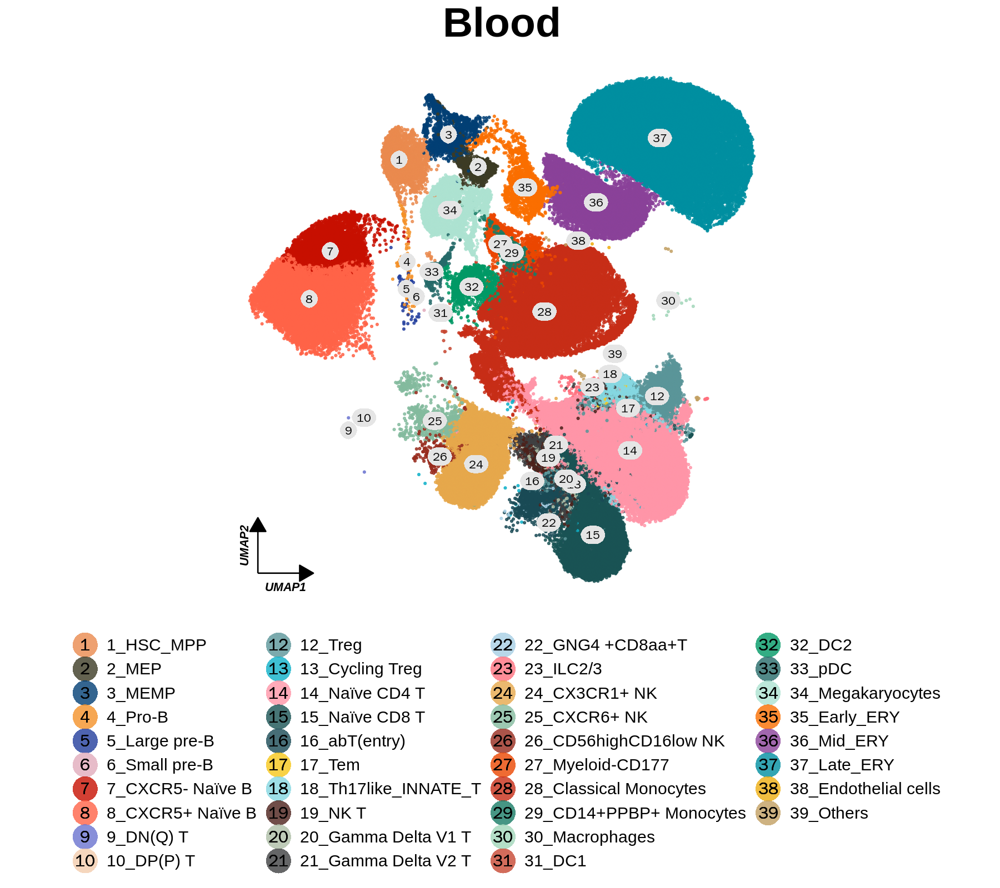

In [38]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
Blood_data<-subset(umap_data ,organ=="PBMC")
dim(Blood_data)
head(Blood_data)
# # print(levels(factor(umap_data$Cell_Type_Code)))

# # numberlabel=length(table( umap_data$Cell_Type))
# # print(numberlabel)
Blood_plot2 <- create_umap_plot(umap_data=Blood_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+ggtitle("Blood")+ 
theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Blood_plot2)
ggsave(plot = Blood_plot2, width = 16, height = 16, "./All_scanpyData/Figure_V2/umap_Blood.pdf")

# A tibble: 5 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.501  7.11
2 6              1.07   6.70
3 19             8.43  -1.97
4 20             9.43  -3.09
5 21             8.87  -1.26
# A tibble: 5 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.501  7.11
2 6              1.07   6.70
3 19             7.63  -1.57
4 20             9.96  -3.99
5 21             9.67  -1.66


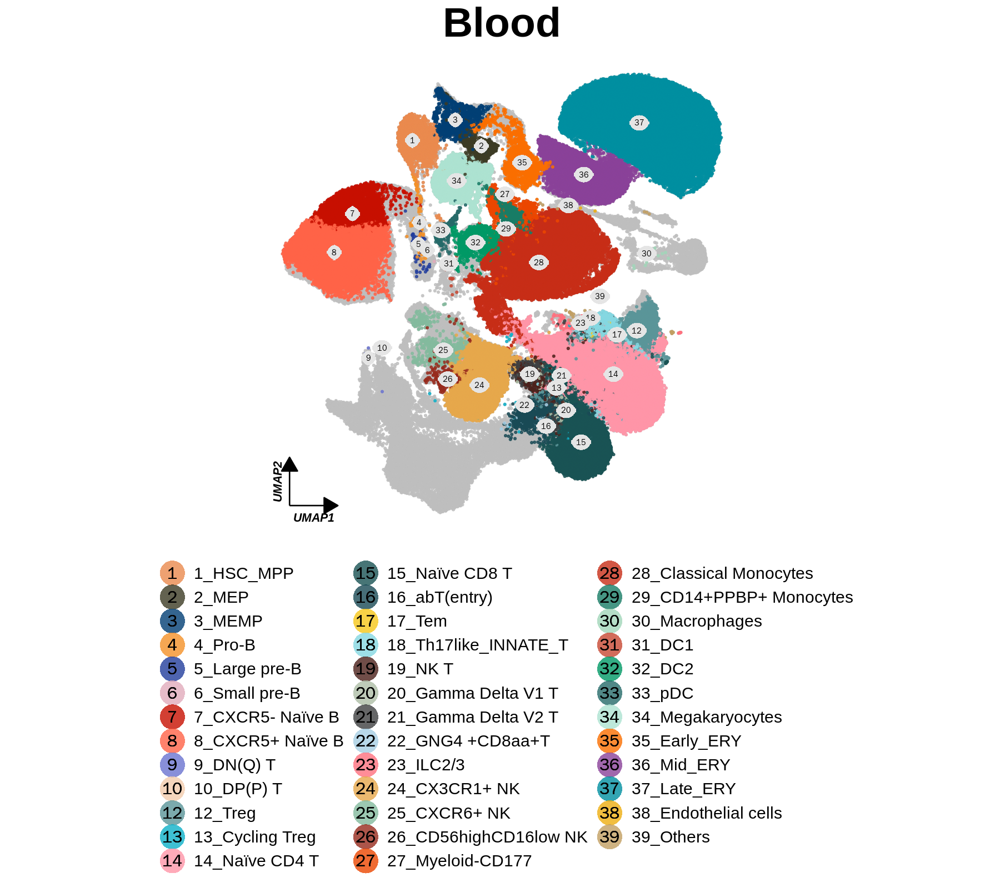

In [39]:
%%R -w 1800 -h 1600 -r 180


umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
Blood_data<-subset(umap_data ,organ=="PBMC")
dim(Blood_data)
head(Blood_data)
# # print(levels(factor(umap_data$Cell_Type_Code)))

# # numberlabel=length(table( umap_data$Cell_Type))
# # print(numberlabel)
Blood_plot2grey <- create_umap_plot_grey(umap_data=Blood_data,alldata=umap_data,position='bottom',legendcol=3, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+ggtitle("Blood")+ 
theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Blood_plot2grey)
ggsave(plot = Blood_plot2grey, width = 16, height = 16,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_PBMC_umap.pdf")

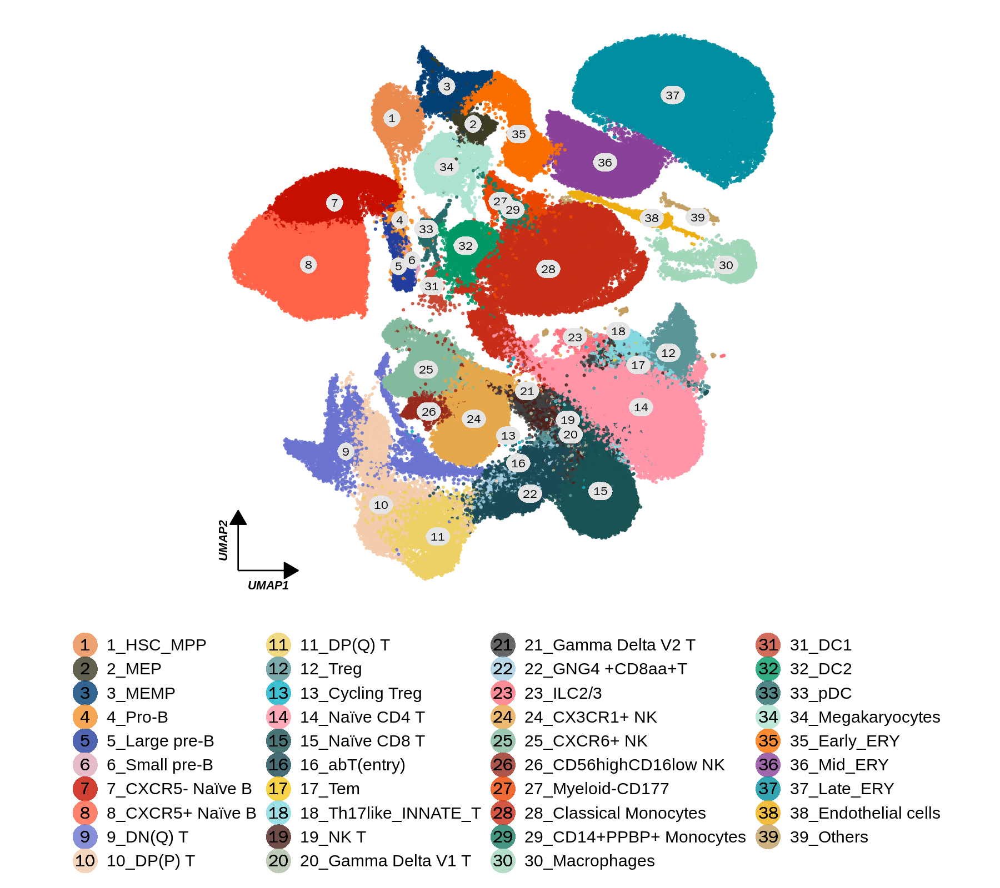

In [40]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)

dim(Blood_data)
head(Blood_data)

All_plot2 <- create_umap_plot(umap_data=umap_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len = 0.1)
# Blood_plot2 
print(All_plot2 )
ggsave(plot = All_plot2 , width = 15, height = 16, "./All_scanpyData/Figure_V2/umap_All.pdf")

In [41]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
# liver_data<-umap_data[grep("liver",umap_data$organ),]


 Liver   PBMC Spleen Thymus 
 27094 172432  18408  27900 


In [42]:
%%R
source("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_script_in_save/HFB_Figure1_Umap.R")

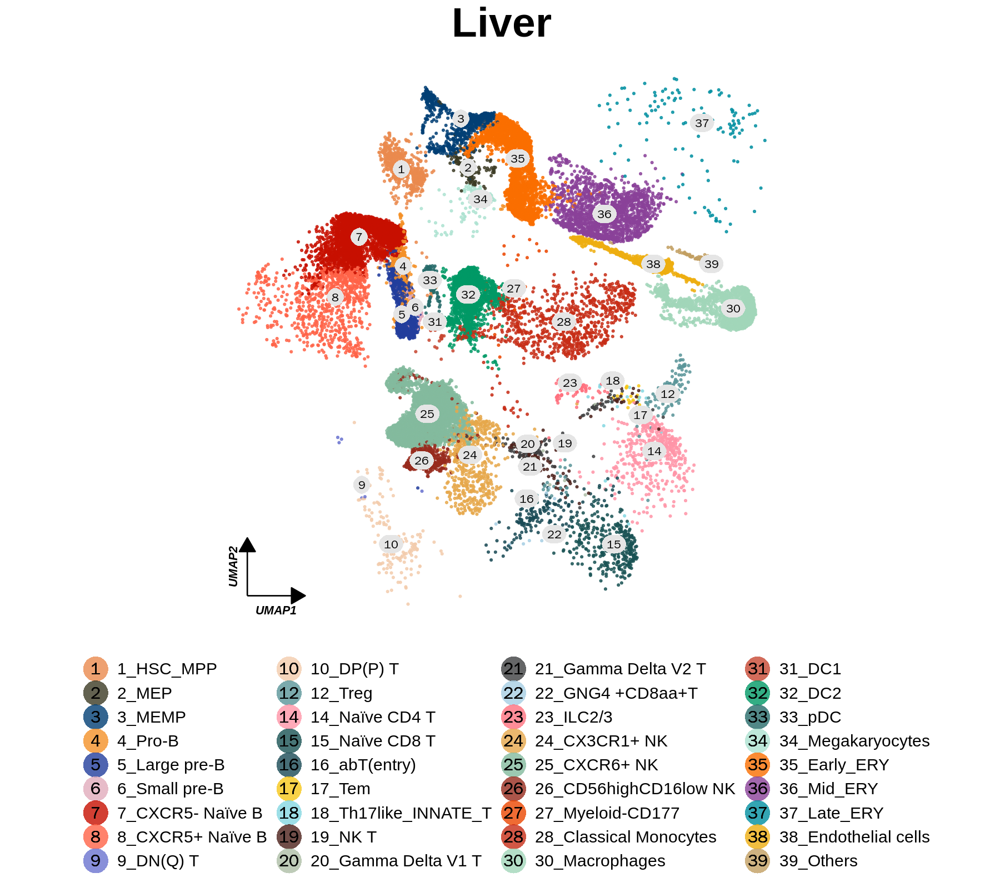

In [43]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
liver_data<-umap_data[grep("Liver",umap_data$organ),]
# dim(Blood_data)
# head(Blood_data)
# print(levels(factor(umap_data$Cell_Type_Code)))

# numberlabel=length(table( umap_data$Cell_Type))
# print(numberlabel)
Liver_plot2 <- create_umap_plot(umap_data=liver_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Liver")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Liver_plot2)
# ggsave(plot = Liver_plot2, width = 16, height = 16, "./All_scanpyData/Figure_V2/umap_Liver.pdf")

In [44]:
%%R
source("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_script_in_save/HFB_Figure1_Umap.R")

# A tibble: 5 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.505  5.96
2 6              1.20   6.34
3 19             7.76  -1.14
4 20             8.05  -1.38
5 21             7.48  -1.08
# A tibble: 5 × 3
  Cell_Type_Code   x_m    y_m
  <fct>          <dbl>  <dbl>
1 5              0.505  5.96 
2 6              1.20   6.34 
3 19             6.16  -0.341
4 20             7.85  -1.68 
5 21             9.28  -1.58 


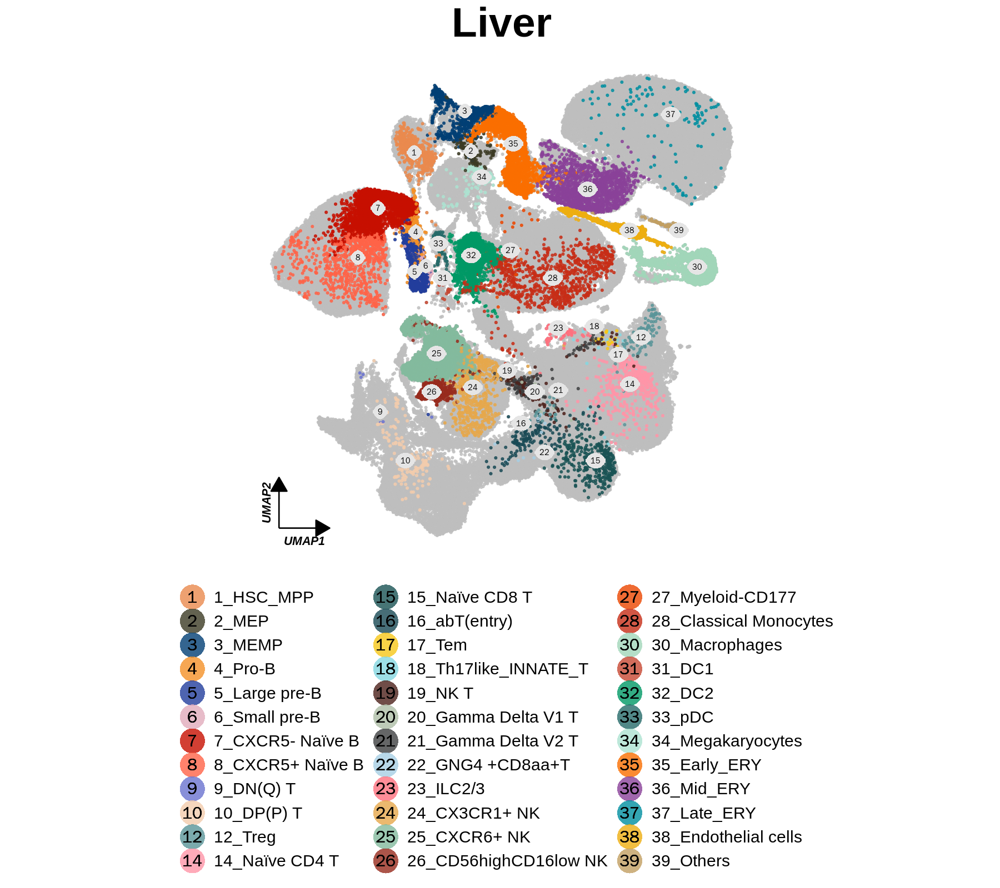

In [45]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
liver_data<-umap_data[grep("Liver",umap_data$organ),]
# dim(Blood_data)
# head(Blood_data)
# print(levels(factor(umap_data$Cell_Type_Code)))

# numberlabel=length(table( umap_data$Cell_Type))
# print(numberlabel)
Liver_plot2grey <- create_umap_plot_grey(umap_data=liver_data,alldata=umap_data,position='bottom',legendcol=3, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Liver")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Liver_plot2grey )
# ggsave(plot = Liver_plot2grey, width = 16, height = 16, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_Liver_umap.pdf")

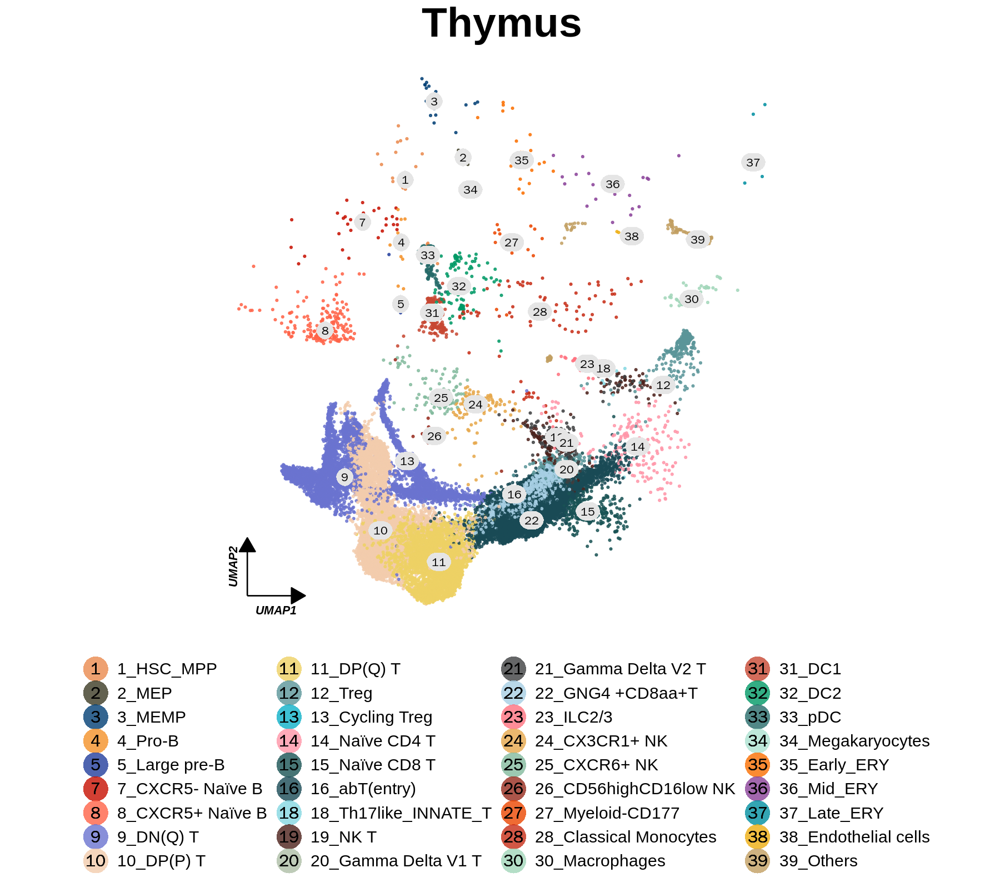

In [46]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
thymus_data<-umap_data[grep("Thymus",umap_data$organ),]

spleen_plot2 <- create_umap_plot(umap_data=thymus_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Thymus")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# spleen_plot2 
print(spleen_plot2 )
ggsave(plot = spleen_plot2, width = 16, height = 16, "./All_scanpyData/Figure_V2/umap_thymus.pdf")

# A tibble: 4 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.610  5.40
2 19             8.50  -1.79
3 20             8.96  -3.52
4 21             8.97  -2.09
# A tibble: 4 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.610  5.40
2 19             7.70  -1.39
3 20             8.96  -3.52
4 21             9.77  -2.49


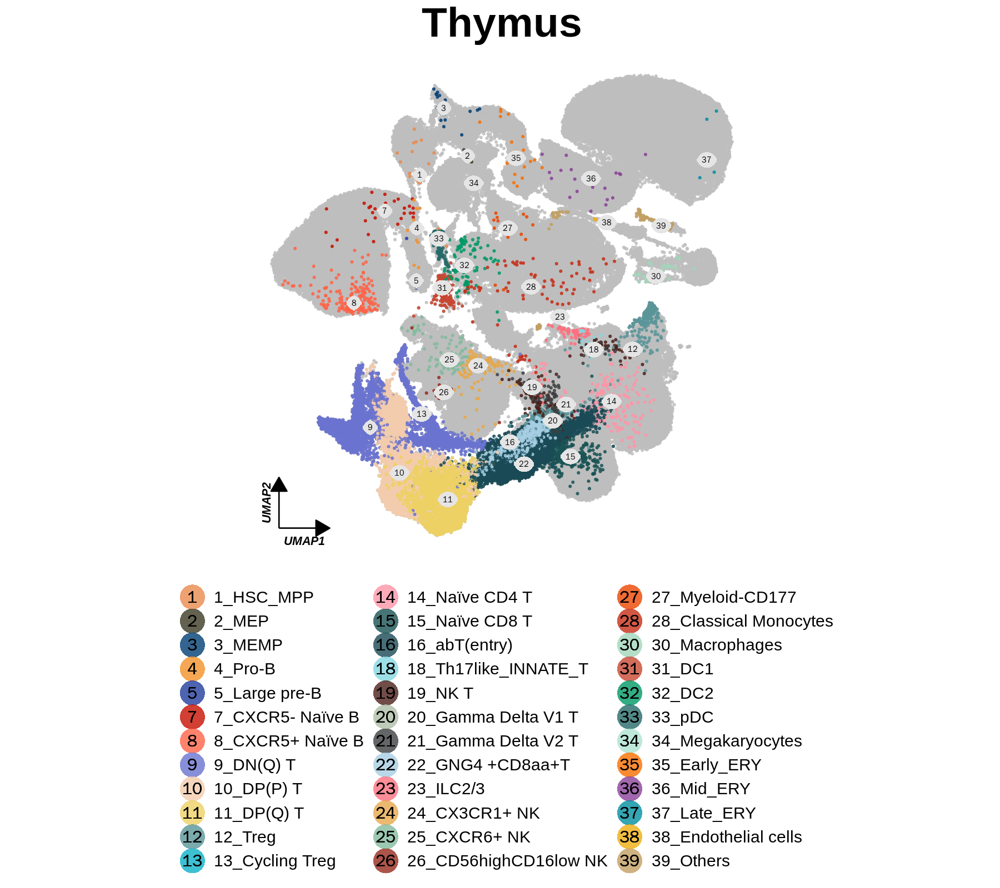

In [47]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Thymus_data<-umap_data[grep("Thymus",umap_data$organ),]

Thymus_plot2grey <- create_umap_plot_grey(umap_data=Thymus_data,alldata=umap_data,position='bottom',legendcol=3, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Thymus")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Thymus_plot2grey )
ggsave(plot = Thymus_plot2grey, width = 10, height = 10, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_Thymus_umap.pdf")

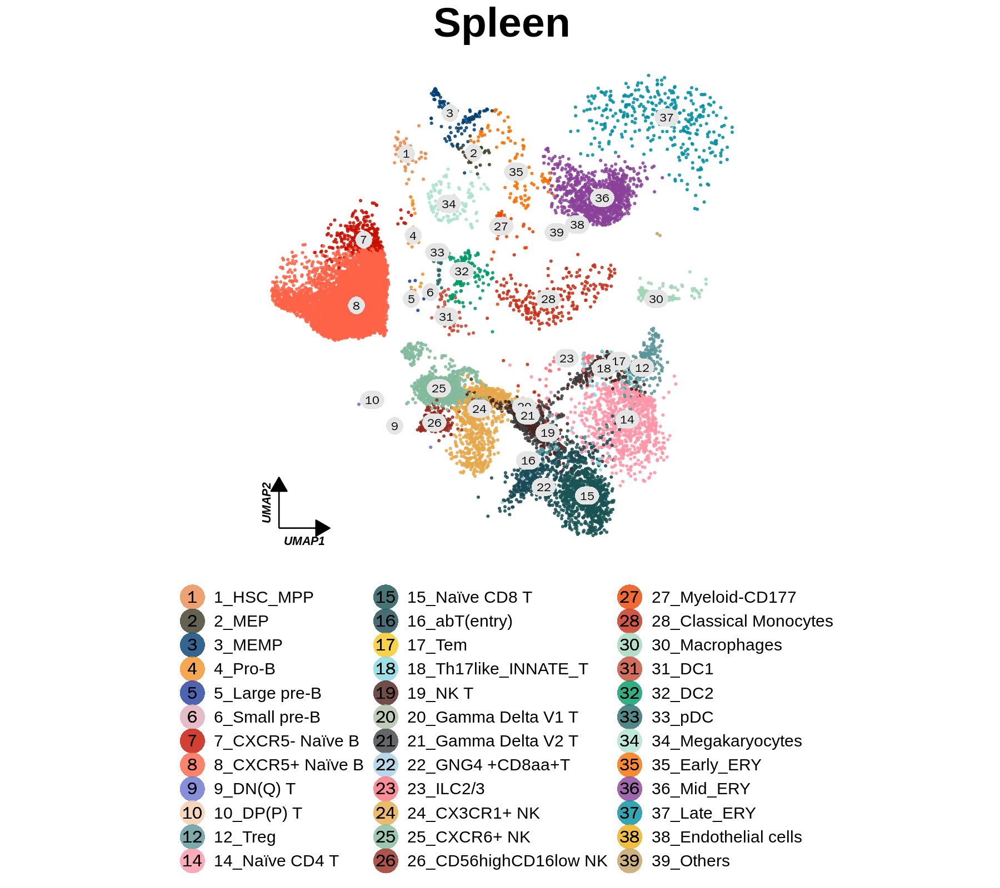

In [48]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
spleen_data<-umap_data[grep("Spleen",umap_data$organ),]

spleen_plot2 <- create_umap_plot(umap_data=spleen_data,position='bottom',legendcol=3, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Spleen")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# spleen_plot2 
print(spleen_plot2 )
ggsave(plot = spleen_plot2, width = 16, height = 16, "./All_scanpyData/Figure_V2/umap_Spleen.pdf")

# A tibble: 5 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.360  5.49
2 6              1.51   5.89
3 19             7.94  -1.31
4 20             7.78  -1.60
5 21             7.37  -1.21
# A tibble: 5 × 3
  Cell_Type_Code   x_m    y_m
  <fct>          <dbl>  <dbl>
1 5              0.360  5.49 
2 6              1.51   5.89 
3 19             6.34  -0.505
4 20             7.58  -1.90 
5 21             9.17  -1.71 


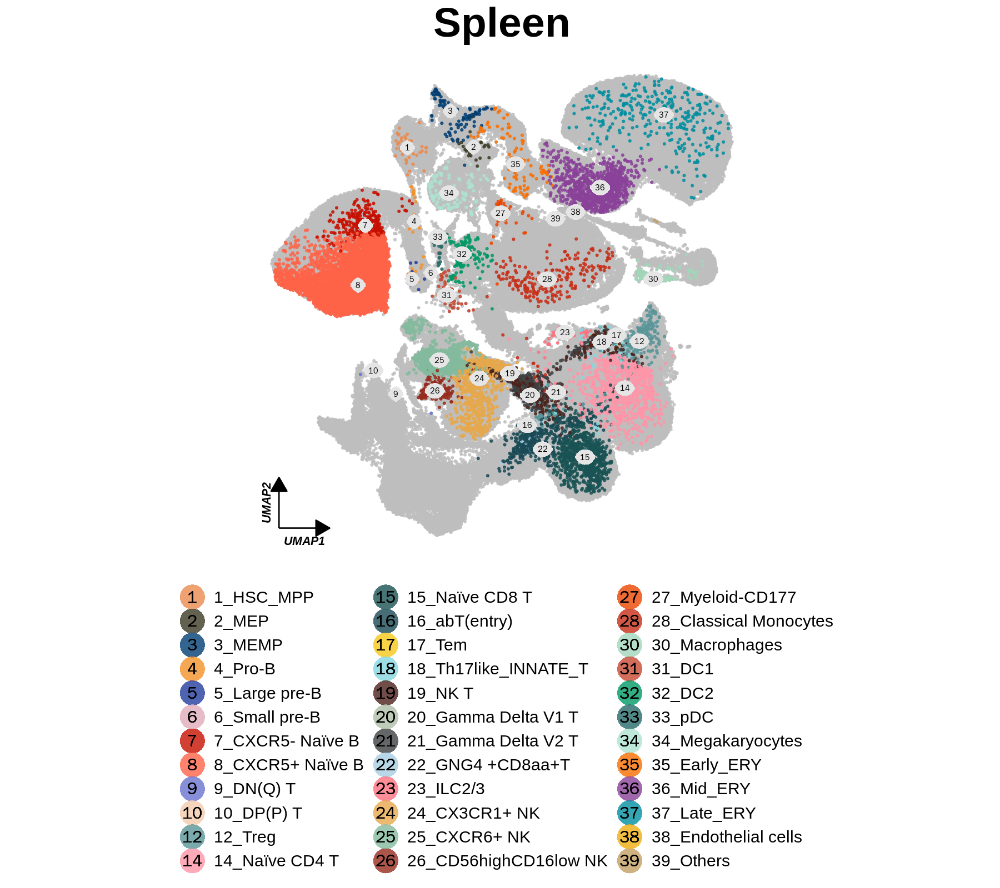

In [49]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Spleen_data<-umap_data[grep("Spleen",umap_data$organ),]

Spleen_plot2grey <- create_umap_plot_grey(umap_data=Spleen_data,alldata=umap_data,position='bottom',legendcol=3, colors_dict=colors_dict)+ geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len=0.1)+
ggtitle("Spleen")+ theme(plot.title = element_text(hjust = 0.5, size = 30, face = "bold"))
# Blood_plot2 
print(Spleen_plot2grey )
# ggsave(plot = Spleen_plot2, width = 16, height = 16, "./All_scanpyData/Figure_V2/umap_Spleen.pdf")
ggsave(plot = Spleen_plot2grey, width = 10, height = 10, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_Spleen_umap.pdf")

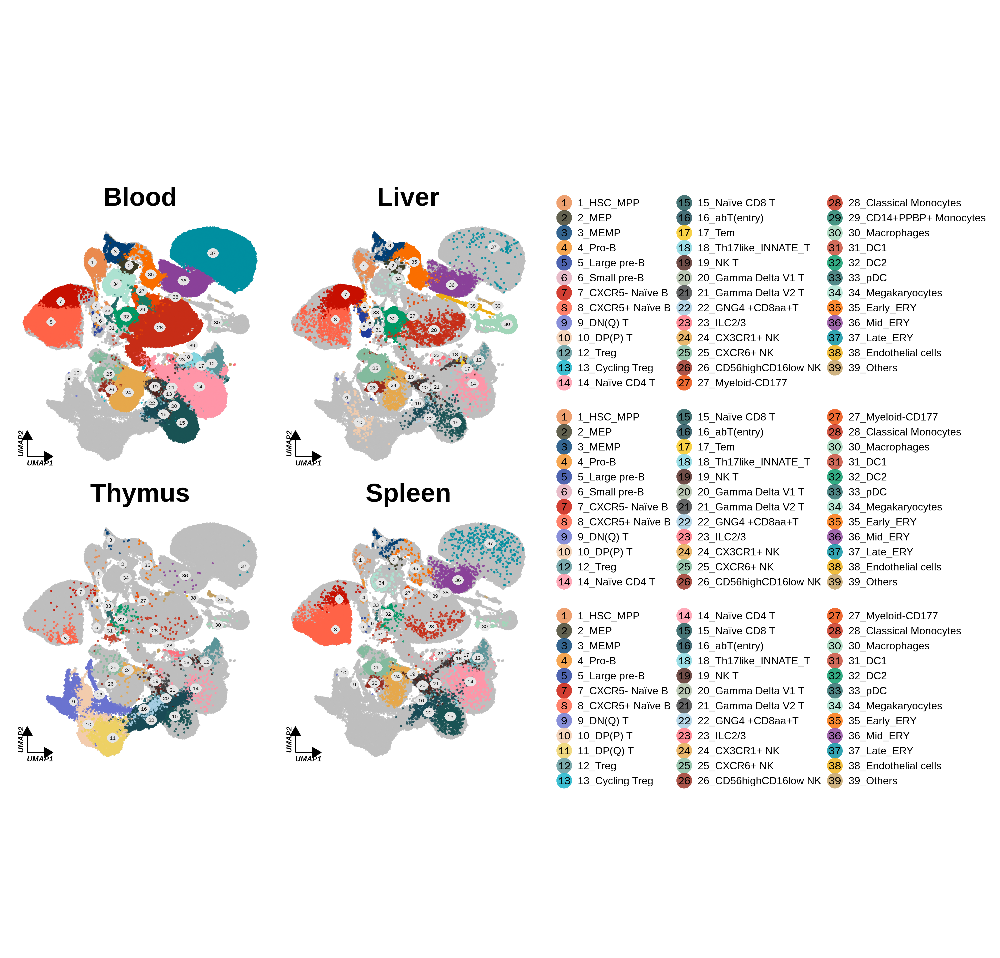

In [50]:
%%R -w 4800 -h 4600 -r 300

library(patchwork)


Organcombined_plot <-   Blood_plot2grey + Liver_plot2grey+Thymus_plot2grey +Spleen_plot2grey


Organcombined_plot  <-Organcombined_plot  + plot_layout(ncol = 2, nrow = 2)+  plot_layout(guides = 'collect') 


Organcombined_plot 

# Organcombined_plot 

In [51]:
%%R
ggsave(plot = Organcombined_plot , width = 20, height = 15, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_Allorgan_umap.pdf")


In [52]:
%%R
output_file <- "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S1/S1_Allorgan_umap.png"


png(filename = output_file, width = 30*200, height = 20*200, res = 300)

print(Organcombined_plot)

dev.off()

png 
  2 


In [53]:
%%R -w 1800 -h 1600 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
NK_data<-umap_data[grep("NK",umap_data$Cell_lineage),]
head(NK_data$Last_cell_type)


[1] "CD56highCD16low NK" "CX3CR1+ NK"         "CX3CR1+ NK"        
[4] "CX3CR1+ NK"         "CX3CR1+ NK"         "CX3CR1+ NK"        


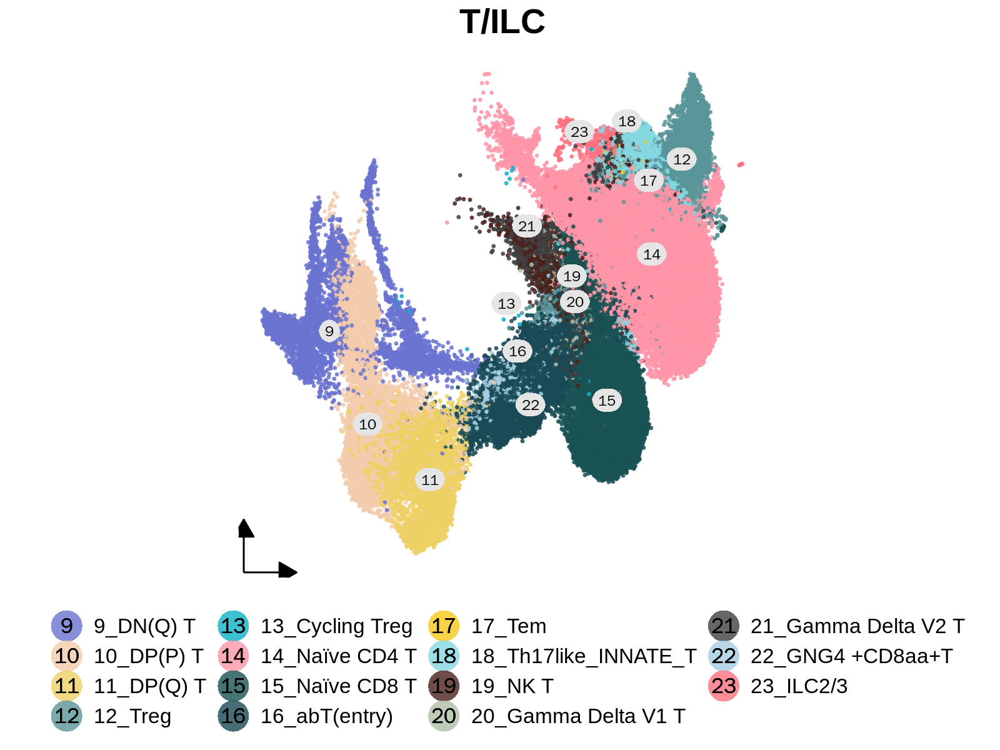

In [54]:
%%R -w 1600 -h 1200 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
TNK_data<-umap_data[grep("T/ILC",umap_data$Cell_lineage),]

TNKILC_plot2 <- create_umap_plot(umap_data=TNK_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("T/ILC")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))
# spleen_plot2 
print(TNKILC_plot2)
ggsave(plot = TNKILC_plot2, width = 12, height = 12, "./All_scanpyData/Figure_V2/umap_NK.pdf")

# A tibble: 3 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 19              8.29 -1.69
2 20              9.40 -3.04
3 21              8.11 -1.26
# A tibble: 3 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 19              7.49 -1.29
2 20              9.40 -3.04
3 21              8.91 -1.66


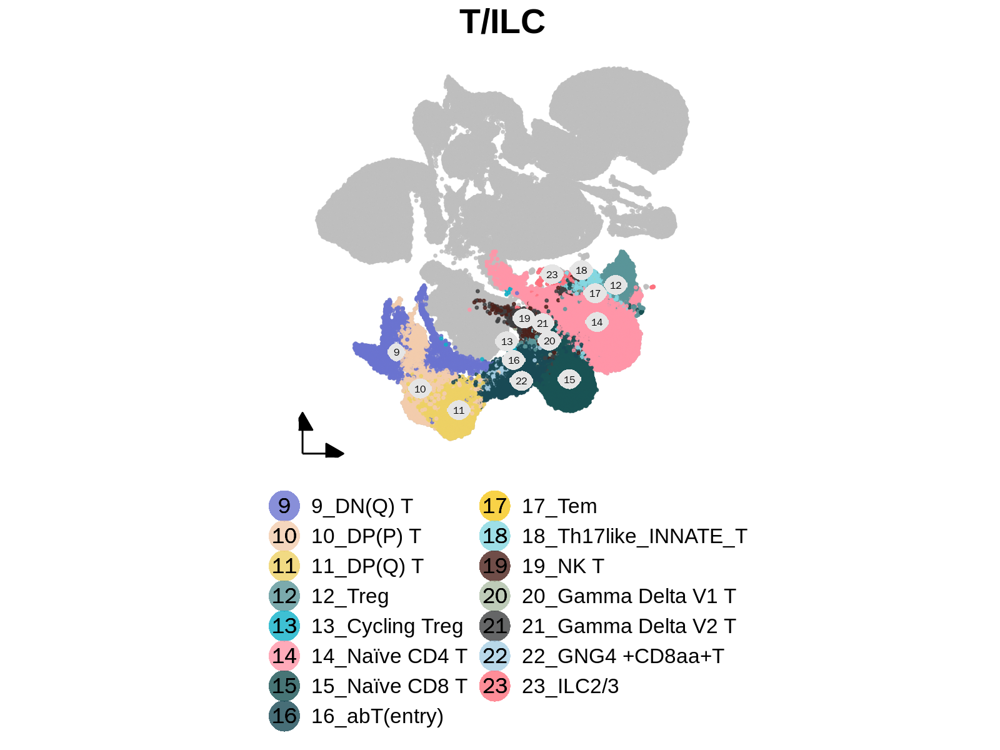

In [55]:
%%R -w 1600 -h 1200 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
TNK_data<-umap_data[grep("T/ILC",umap_data$Cell_lineage),]

TNKILC_plot2grey <- create_umap_plot_grey(umap_data=TNK_data,alldata=umap_data,position='bottom',legendcol=2, colors_dict=colors_dict)+
geom_markArrow(data = umap_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("T/ILC")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))
# spleen_plot2 
print(TNKILC_plot2grey)
ggsave(plot = TNKILC_plot2grey, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_TILC_umap.pdf")


# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


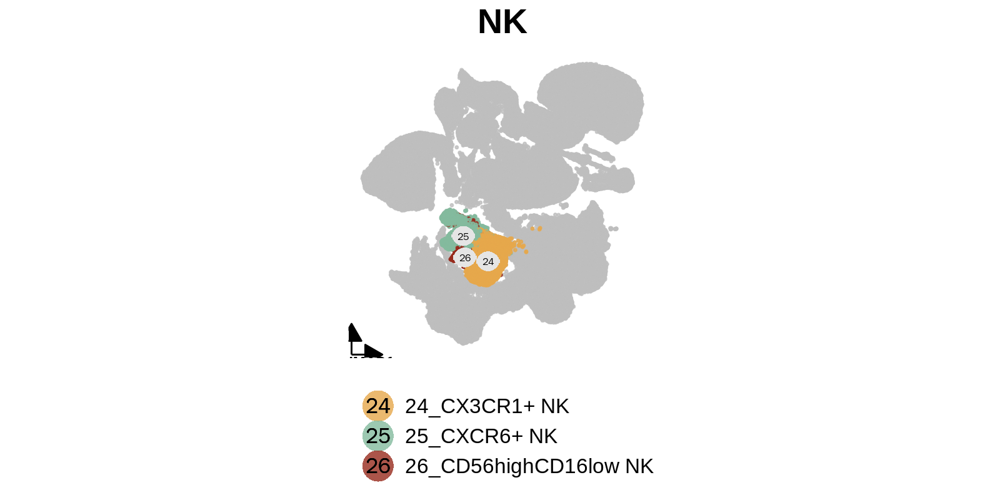

In [56]:
%%R -w 1600 -h 800 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
NK_data<-umap_data[grep(" NK",umap_data$Last_cell_type),]

NK_plot2grey <- create_umap_plot_grey(umap_data=NK_data,alldata=umap_data ,position='bottom',legendcol=1, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data,rel.pos = 0.01,rel.len = 0.1)+
ggtitle("NK")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))
# spleen_plot2 
print(NK_plot2grey)
ggsave(plot = NK_plot2grey, width = 8, height = 8,  "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_NK_umap.pdf")

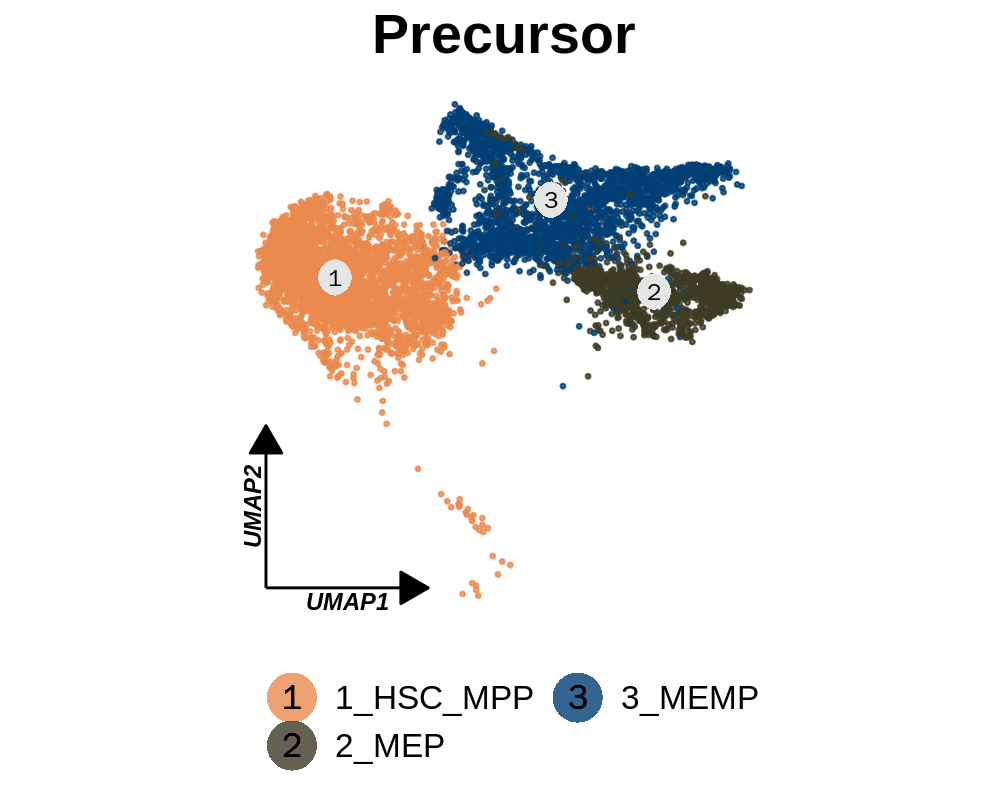

In [57]:
%%R -w 1000 -h 800 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Pro_data<-umap_data[grep("PRE",umap_data$Cell_lineage),] 

Pro_plot2 <- create_umap_plot(umap_data=Pro_data,position='bottom',legendcol=2, colors_dict=colors_dict)+ geom_markArrow(data = Pro_data, rel.pos = 0.06)+
ggtitle("Precursor")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(Pro_plot2)
ggsave(plot = Pro_plot2, width = 6, height = 6, "./All_scanpyData/Figure_V2//Umap_Pro.pdf")

# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


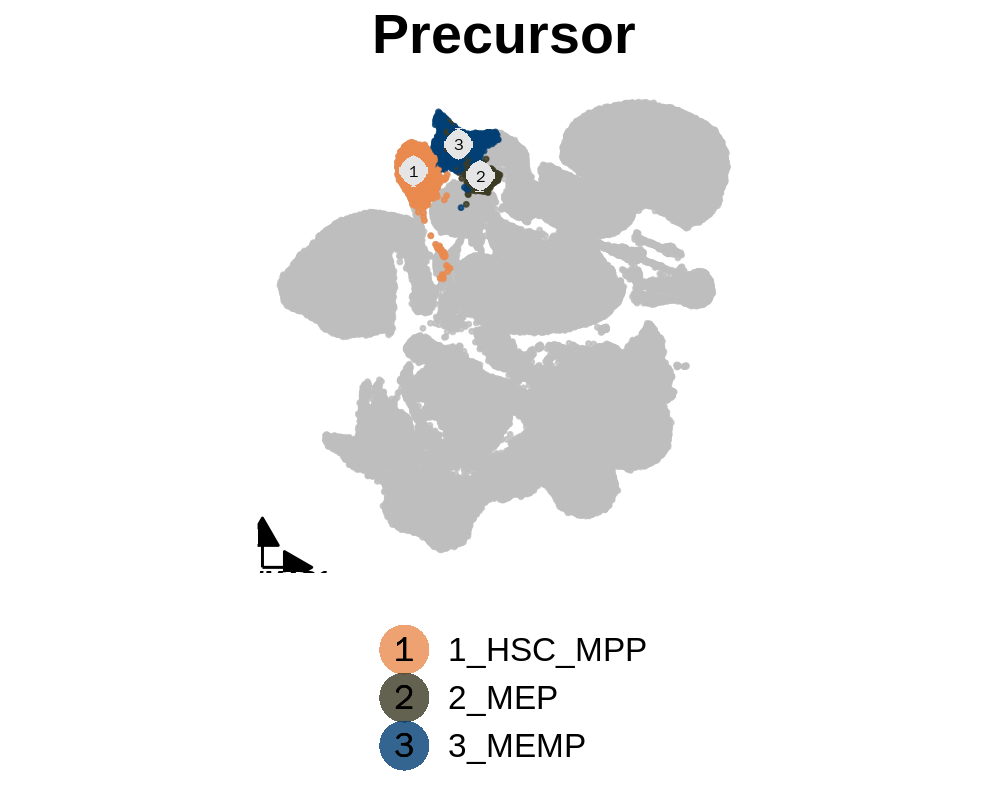

In [58]:
%%R -w 1000 -h 800 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Pro_data<-umap_data[grep("PRE",umap_data$Cell_lineage),] 

Pro_plot2grey <- create_umap_plot_grey(umap_data=Pro_data,position='bottom',alldata=umap_data,legendcol=1, colors_dict=colors_dict)+
geom_markArrow(data = Pro_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("Precursor")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(Pro_plot2grey)
ggsave(plot = Pro_plot2grey, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_Precursor_umap.pdf")

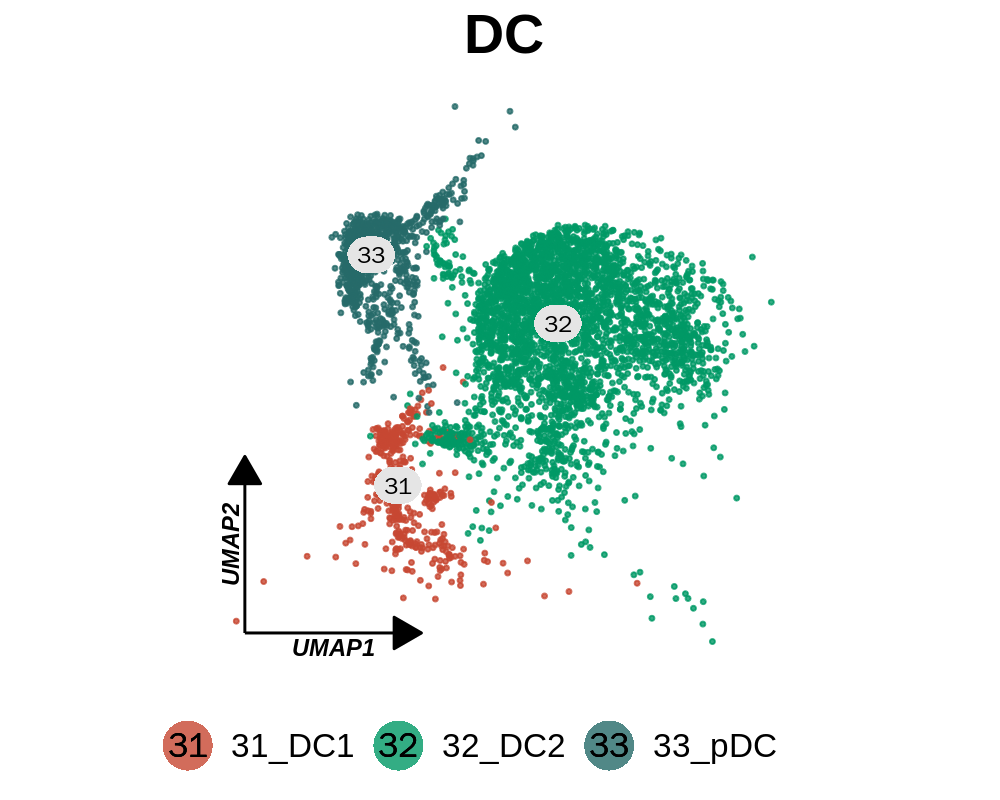

In [59]:
%%R -w 1000 -h 800 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("DC",umap_data$Cell_lineage),]

DC_plot2 <- create_umap_plot(umap_data=Pro_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ geom_markArrow(data = Pro_data, rel.pos = 0.06)+
ggtitle("DC")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(DC_plot2)
ggsave(plot =DC_plot2, width = 8, height = 8, "./All_scanpyData/Figure_V2//Umap_DC.pdf")

# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


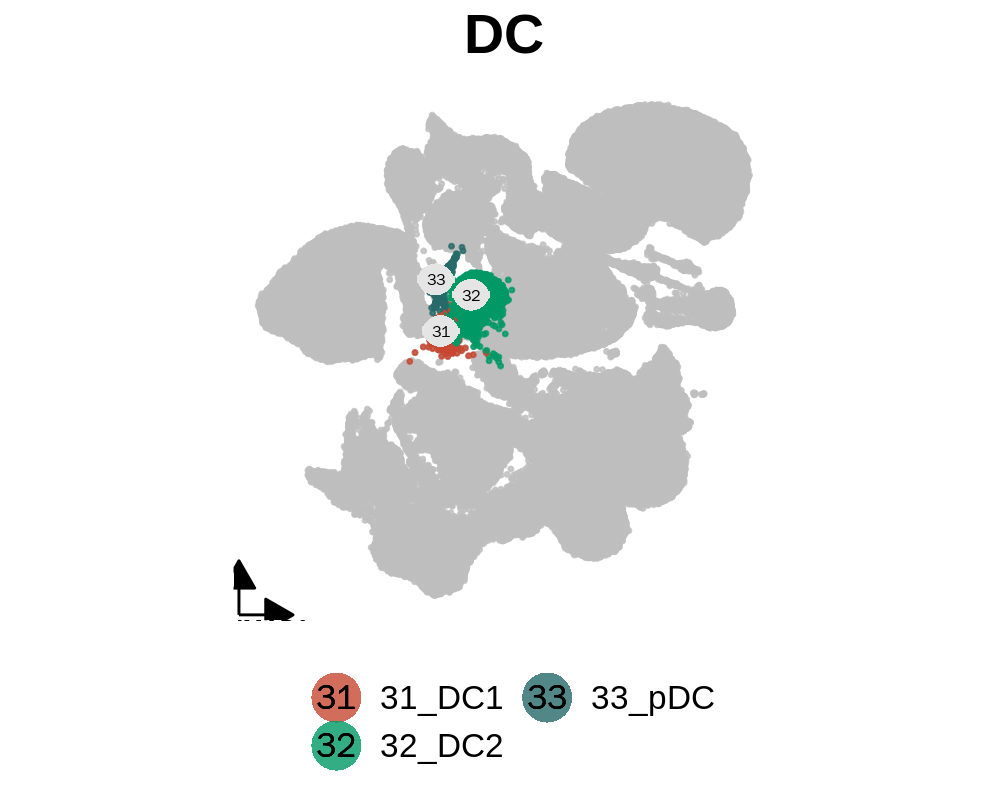

In [60]:
%%R -w 1000 -h 800 -r 200

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("DC",umap_data$Cell_lineage),]

DC_plot2grey <- create_umap_plot_grey(umap_data=Pro_data,alldata=umap_data,position='bottom',legendcol=2, colors_dict=colors_dict)+
geom_markArrow(data = Pro_data,rel.pos = 0.01,rel.len = 0.1)+
ggtitle("DC")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(DC_plot2grey)
ggsave(plot =DC_plot2grey, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_DC_umap.pdf")

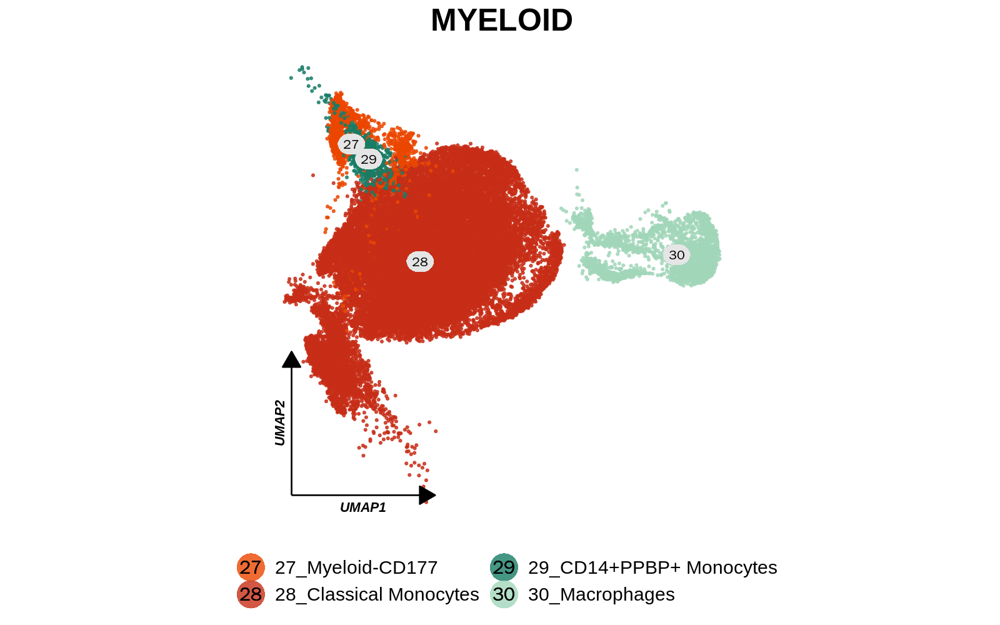

In [61]:
%%R -w 1600 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("Mono|My|Mac",umap_data$Last_cell_type),]

MYELOID_plot2 <- create_umap_plot(umap_data=Pro_data,position='bottom',legendcol=2, colors_dict=colors_dict)+ geom_markArrow(data = Pro_data, rel.pos = 0.06)+
ggtitle("MYELOID")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(MYELOID_plot2)
ggsave(plot = MYELOID_plot2, width = 12, height = 12, "./All_scanpyData/Figure_V2//Umap_MYELOID.pdf")

# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


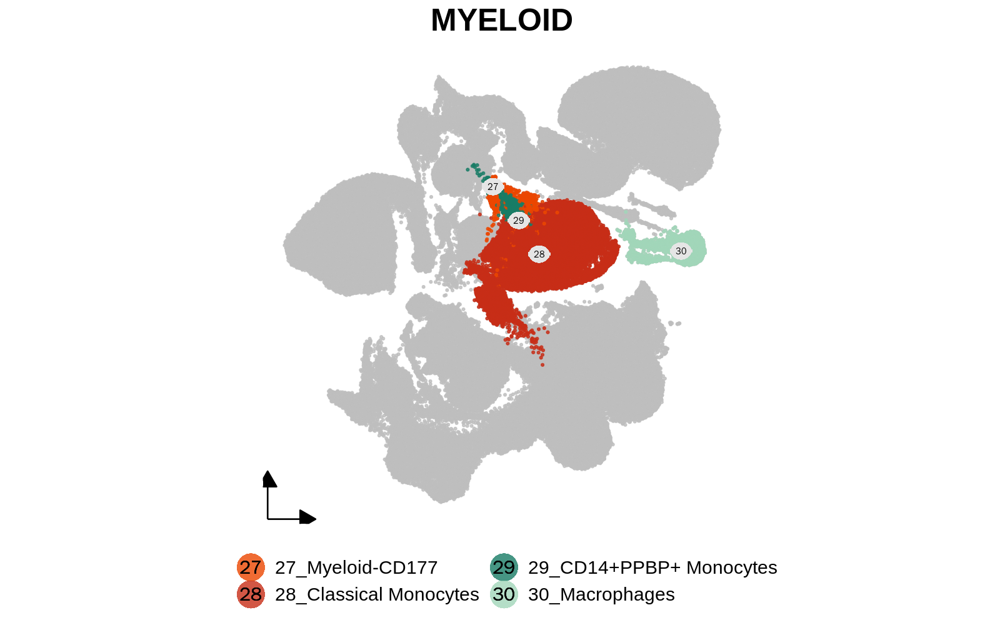

In [62]:
%%R -w 1600 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData//adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("Mono|My|Mac",umap_data$Last_cell_type),]

MYELOID_plot2grey <- create_umap_plot_grey(umap_data=Pro_data,alldata=umap_data,position='bottom',legendcol=2, colors_dict=colors_dict)+ 
geom_markArrow(data = Pro_data,rel.pos = 0.01,rel.len = 0.1)+
ggtitle("MYELOID")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(MYELOID_plot2grey)
ggsave(plot = MYELOID_plot2grey, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_MYELOID_umap.pdf")

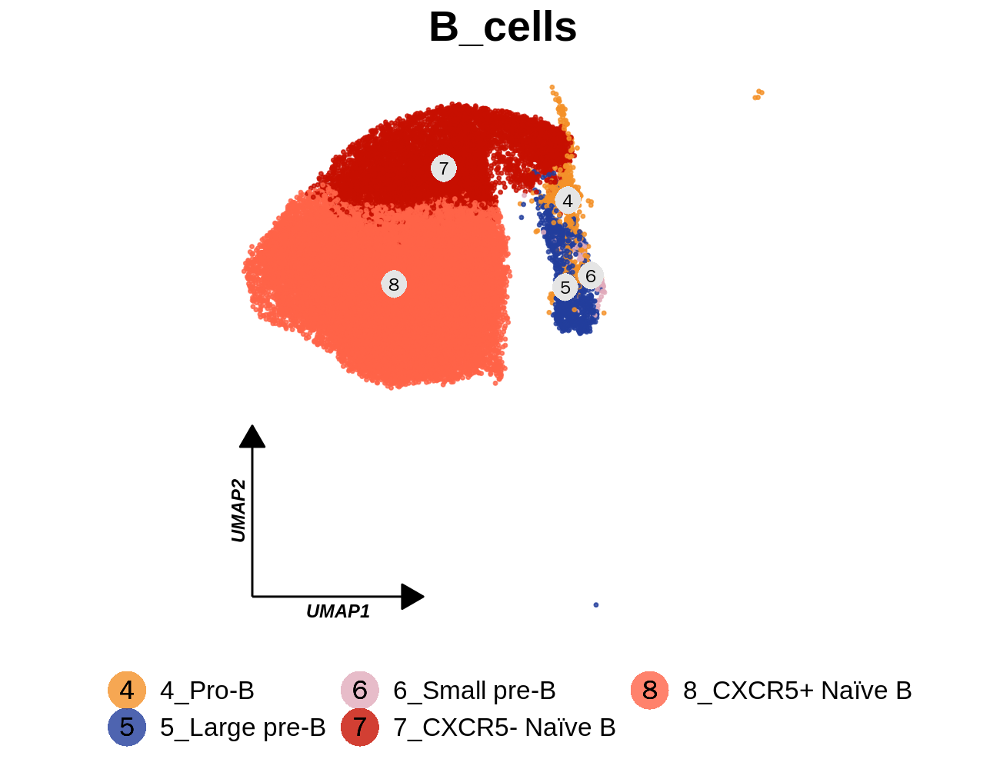

In [63]:
%%R -w 1300 -h 1000 -r 200

umap_data <- read.csv("./All_scanpyData//UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage)
Pro_data<-umap_data[grep("B",umap_data$Cell_lineage),]

Bcell_plot2 <- create_umap_plot(umap_data=Pro_data,position='bottom',legendcol=3,colors_dict=colors_dict)+ geom_markArrow(data = Pro_data, rel.pos = 0.06)+
ggtitle("B_cells")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(Bcell_plot2)
ggsave(plot = Bcell_plot2, width = 12, height = 8, "./All_scanpyData/Figure_V2//Umap_Bcell.pdf")

# A tibble: 2 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.504  6.01
2 6              1.20   6.34
# A tibble: 2 × 3
  Cell_Type_Code   x_m   y_m
  <fct>          <dbl> <dbl>
1 5              0.504  6.01
2 6              1.20   6.34


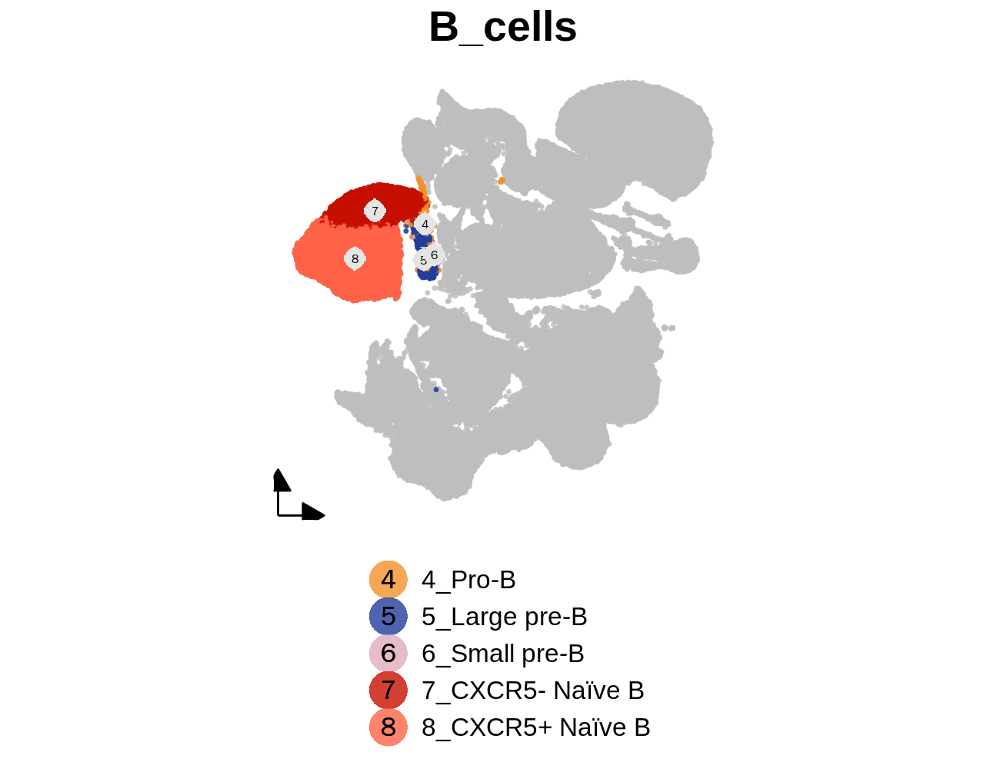

In [64]:
%%R -w 1300 -h 1000 -r 200

umap_data <- read.csv("./All_scanpyData//UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage)
Pro_data<-umap_data[grep("B",umap_data$Cell_lineage),]

Bcell_plot2grey <- create_umap_plot_grey(umap_data=Pro_data,alldata=umap_data,position='bottom',legendcol=1,colors_dict=colors_dict)+
geom_markArrow(data = Pro_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("B_cells")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(Bcell_plot2grey)
ggsave(plot = Bcell_plot2grey, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_Bcell_umap.pdf")

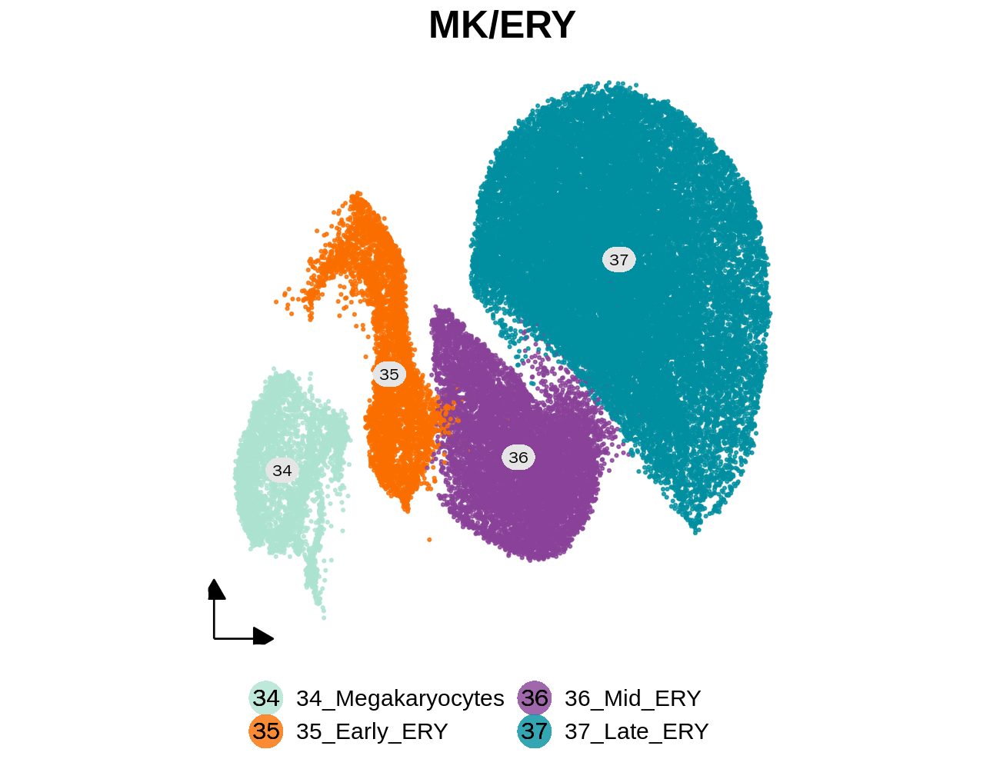

In [65]:
%%R -w 1300 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("MK",umap_data$Cell_lineage),]

MKERY_plot2 <- create_umap_plot(umap_data=Pro_data,position='bottom',legendcol=3,colors_dict=colors_dict)+
geom_markArrow(data = Pro_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("MK/ERY")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(MKERY_plot2 )
ggsave(plot = MKERY_plot2, width = 12, height = 8, "./All_scanpyData/Figure_V2//Umap_MKERY.pdf")

# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


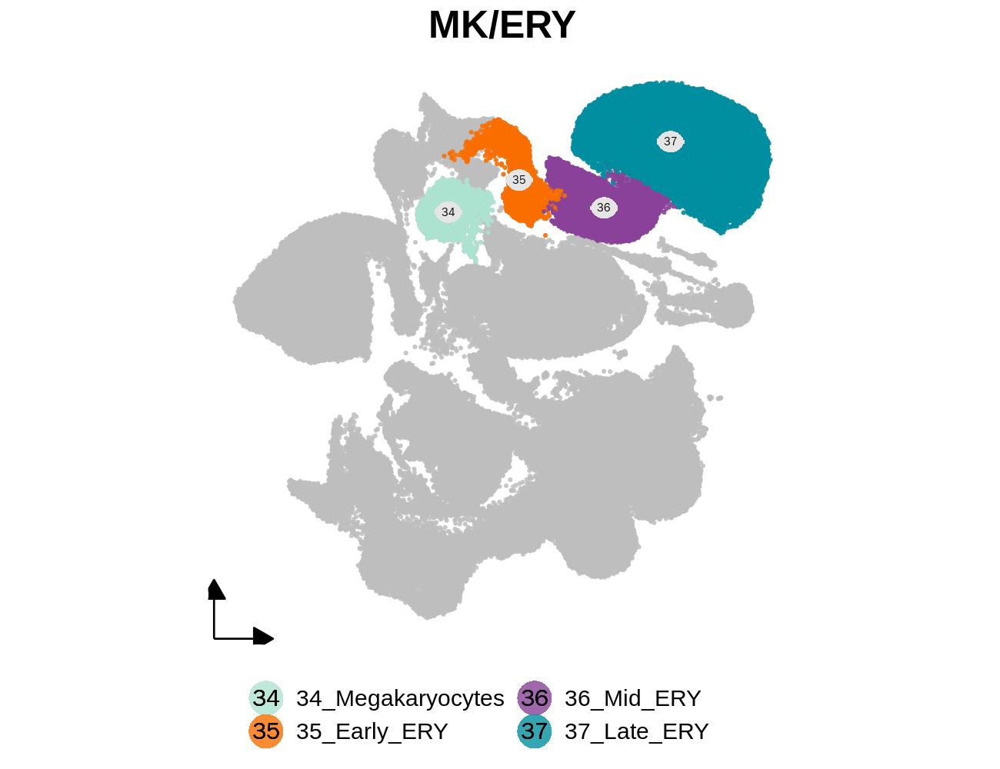

In [66]:
%%R -w 1300 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$Cell_lineage2 )
Pro_data<-umap_data[grep("MK",umap_data$Cell_lineage),]

MKERY_plot2grey <- create_umap_plot_grey(umap_data=Pro_data,alldata=umap_data,position='bottom',legendcol=3,colors_dict=colors_dict)+
geom_markArrow(data = Pro_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("MK/ERY")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(MKERY_plot2grey )
ggsave(plot = MKERY_plot2grey, width = 8, height = 8, ggsave(plot = Bcell_plot2, width = 8, height = 8, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_MKERY_umap.pdf"))

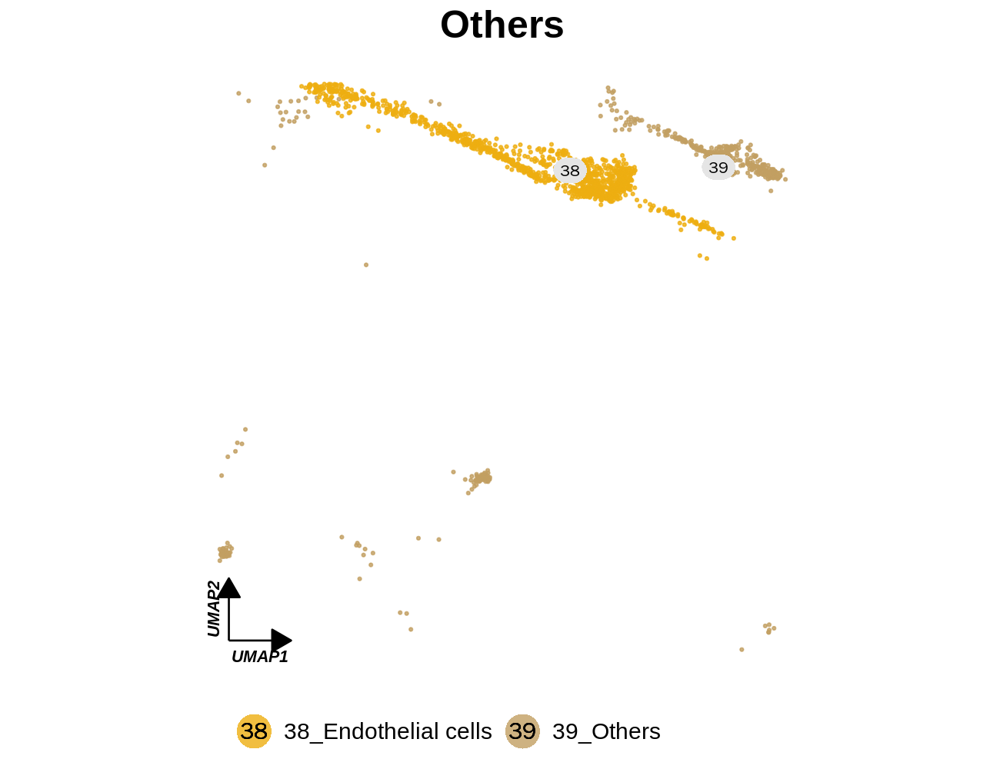

In [67]:
%%R -w 1300 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Others_data<-umap_data[grep("En|Others",umap_data$Last_cell_type),]

Others_plot2 <- create_umap_plot(umap_data=Others_data,position='bottom',legendcol=4, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.06,rel.len = 0.1)+
ggtitle("Others")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))
# spleen_plot2 
print(Others_plot2)
ggsave(plot = Others_plot2, width = 12, height = 12, "./All_scanpyData/Figure_V2/umap_Others.pdf")

# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>
# A tibble: 0 × 3
# ℹ 3 variables: Cell_Type_Code <fct>, x_m <dbl>, y_m <dbl>


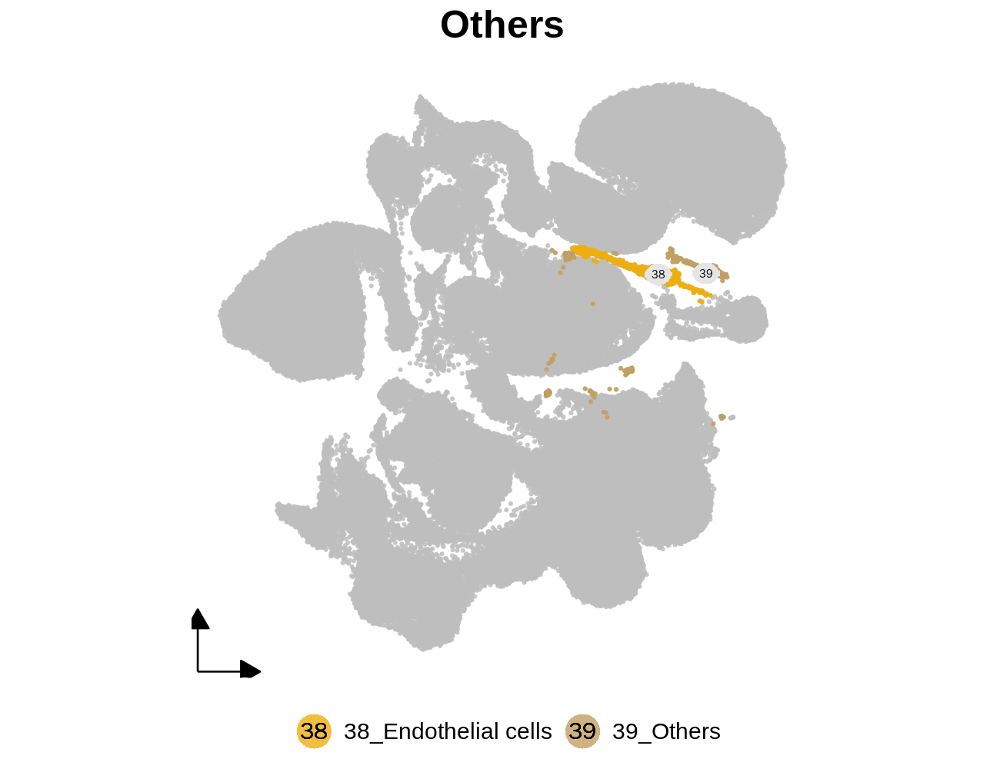

In [68]:
%%R -w 1300 -h 1000 -r 180

umap_data <- read.csv("./All_scanpyData/UmapData/adata1_umap_obsdata.csv", row.names = 1)
table(umap_data$organ )
Others_data<-umap_data[grep("En|Others",umap_data$Last_cell_type),]

Others_plot2grey<- create_umap_plot_grey(umap_data=Others_data,alldata=umap_data,position='bottom',legendcol=2, colors_dict=colors_dict)+ 
geom_markArrow(data = umap_data, rel.pos = 0.01,rel.len = 0.1)+
ggtitle("Others")+ theme(plot.title = element_text(hjust = 0.5, size = 20, face = "bold"))

print(Others_plot2grey)
# ggsave(plot = Others_plot2, width = 12, height = 12, "./All_scanpyData/Figure_V2/umap_Others.pdf")
ggsave(plot = Others_plot2grey, width = 8, height = 8,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_Others_umap.pdf")

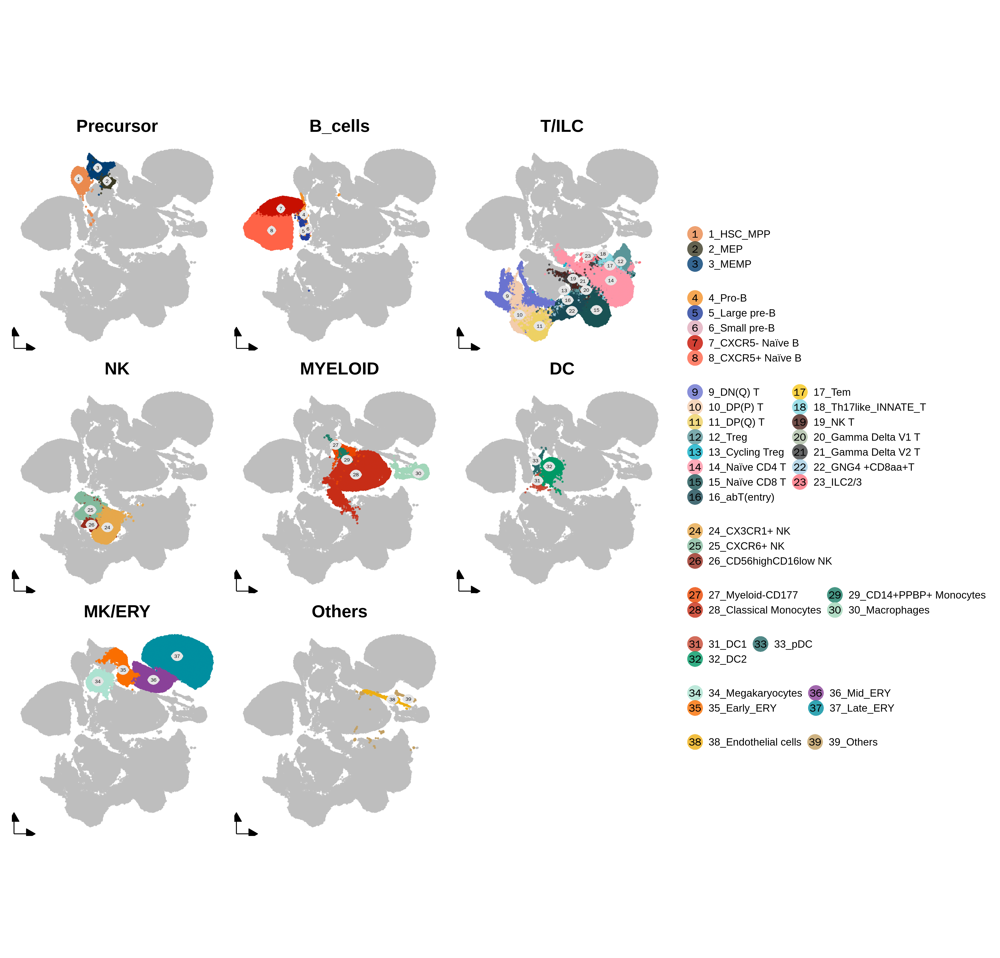

In [69]:
%%R -w 4800 -h 4600 -r 300

library(patchwork)


Cellcombined_plot <-    Pro_plot2grey+Bcell_plot2grey+TNKILC_plot2grey+NK_plot2grey +MYELOID_plot2grey+DC_plot2grey+ MKERY_plot2grey +Others_plot2grey


Cellcombined_plot   <-Cellcombined_plot  + plot_layout(ncol = 3, nrow = 3)+  plot_layout(guides = 'collect') 


Cellcombined_plot 

# Organcombined_plot 

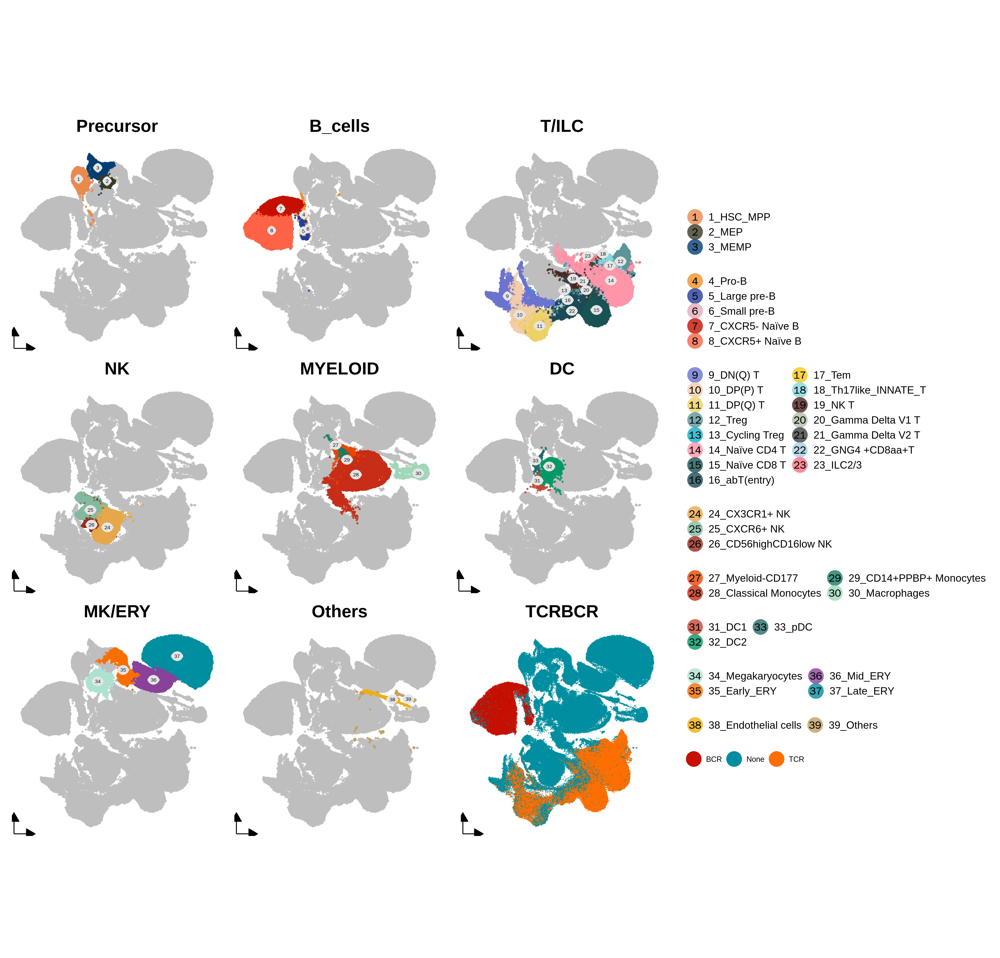

In [70]:
%%R -w 4800 -h 4600 -r 300

library(patchwork)


Cellcombined_plot1 <-    Pro_plot2grey+Bcell_plot2grey+TNKILC_plot2grey+NK_plot2grey +MYELOID_plot2grey+DC_plot2grey+ MKERY_plot2grey +Others_plot2grey+umap_TCRBCR


Cellcombined_plot1   <-Cellcombined_plot1  + plot_layout(ncol = 3, nrow = 3)+  plot_layout(guides = 'collect') 


Cellcombined_plot1 

# Organcombined_plot 

In [71]:
%%R
ggsave(plot =Cellcombined_plot1 , width =20, height = 20,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S2_All_umap2.pdf", useDingbats = TRUE)

In [72]:
%%R
output_file1 <- "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure1/S2/S1_Allcell_umap.png"


png(filename = output_file1, width = 30*200, height = 20*200, res = 300)

print(Cellcombined_plot1 )

dev.off()

png 
  2 


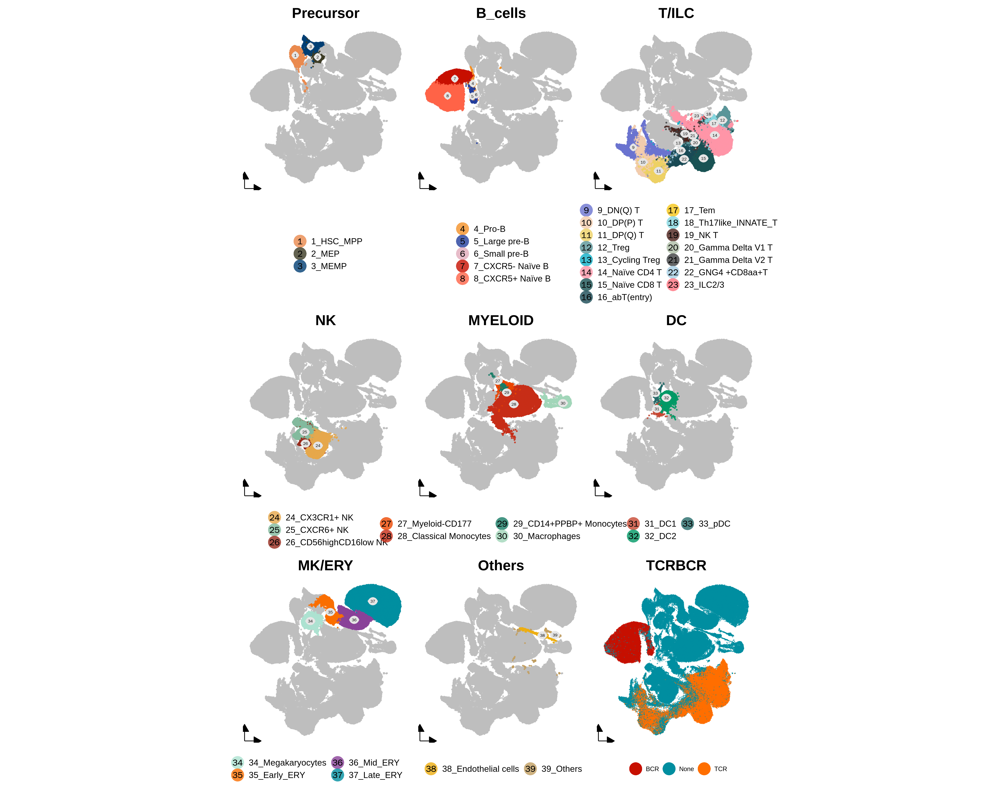

In [73]:
%%R -w 5800 -h 4600 -r 300

library(patchwork)


Cellcombined_plot2 <-    Pro_plot2grey+Bcell_plot2grey+TNKILC_plot2grey+NK_plot2grey +MYELOID_plot2grey+DC_plot2grey+ MKERY_plot2grey +Others_plot2grey+umap_TCRBCR


Cellcombined_plot2   <-Cellcombined_plot2  + plot_layout(ncol = 3, nrow = 3)


Cellcombined_plot2 

# Organcombined_plot 